<a href="https://colab.research.google.com/github/sailorcosmos101/3D-PINN-for-GW/blob/main/3DPINNforGW_case1_0421.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import sys
import numpy as np
import jax
import jax.numpy as jnp
from jax import random, jit, grad, vmap, jacfwd, jacrev
import optax
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
from matplotlib import cm
import matplotlib as mpl
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from mpl_toolkits.mplot3d import Axes3D
import pickle

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Define the 3D domain
xmin, xmax = 0.0, 22900  # X-boundary
ymin, ymax = 0.0, 22900  # Y-boundary
zmin, zmax = -137.16, 60.96  # Z-boundary

In [ ]:
N_b = 10000  # Increase number of boundary points per boundary condition points
N_r = 20000  # Increase number of collocation points within the domain

# Define the boundary conditons
h_const = 0 # Constant head boundary condition
f_no = 0 # No-flow boundary condition
W_re = 7.9*10**-5 # Recharge rate (m/d)

In [ ]:
# Define hydraulic conductivity function
def hydraulic_conductivity(x, y, z):
    """
    Define piecewise hydraulic conductivity K.
    """
    K_x =  jnp.ones_like(x) * 15
    K_y =  jnp.ones_like(y) * 15
    K_z =  jnp.ones_like(z) * 1.5
    return K_x, K_y, K_z

In [ ]:
def drain_elev(x, e_max = 100, L=12192, x_shift = 2286):
    return (e_max / L) * (x - x_shift)

In [ ]:
def drain_discharge(h_pred, x_drain, C_d = 0.09):
    d_x = drain_elev(x_drain)
    return jnp.where(h_pred < d_x, 0.0, -C_d * (h_pred - d_x))

In [ ]:
def generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax):
    bk1, bk2, bk3, bk4, bk5, bk6, r1k, r2k, r3k = jax.random.split(jax.random.PRNGKey(0), 9)

    # 1 --- Constant Head Boundary 생성 ---
    y_linspace_const = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_const = jnp.linspace(-91.44, zmax, int(jnp.sqrt(N_b)))  # (-91.44, 60.96)
    Y_mesh_const, Z_mesh_const = jnp.meshgrid(y_linspace_const, z_linspace_const)
    y_const = Y_mesh_const.ravel().reshape(-1, 1)
    z_const = Z_mesh_const.ravel().reshape(-1, 1)
    x_const = jnp.full_like(y_const, xmin)  # x = 0
    bc_const = jnp.ones_like(y_const) * h_const
    BC_const = jnp.concatenate([x_const, y_const, z_const, bc_const], axis=1)

    # 2 --- Recharge Boundary 생성 ---
    x_linspace_re = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    y_linspace_re = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    X_mesh_re, Y_mesh_re = jnp.meshgrid(x_linspace_re, y_linspace_re)
    x_re = X_mesh_re.ravel().reshape(-1, 1)
    y_re = Y_mesh_re.ravel().reshape(-1, 1)
    z_re = jnp.full_like(x_re, zmax)  # z = 60.96
    bc_re = jnp.ones_like(x_re) * W_re
    BC_re = jnp.concatenate([x_re, y_re, z_re, bc_re], axis=1)

    # 3 --- Drainage Boundary (y=11430, z=60.96) 생성 ---
    x_linspace_dr = jnp.linspace(2286, 14478, int(jnp.sqrt(N_b)))
    y_linspace_dr = jnp.array([11430.0])  # 고정된 y
    X_mesh_dr, _ = jnp.meshgrid(x_linspace_dr, y_linspace_dr)
    x_dr = X_mesh_dr.ravel().reshape(-1, 1)
    y_dr = jnp.full_like(x_dr, 11430.0)
    z_dr = jnp.full_like(x_dr, zmax)  # z = 60.96
    q_dr = jnp.zeros_like(x_dr) # Drainage는 bc 값을 h(x,y,z) 기반으로 계산해야 하므로, 초기 bc는 일단 dummy 값으로
    BC_dr = jnp.concatenate([x_dr, y_dr, z_dr, q_dr], axis=1)

    # 4 --- No-flow Boundary at x=xmin, z <= -91.44 ---
    y_linspace_nf_xmin = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_nf_xmin = jnp.linspace(-137.16, -91.44, int(jnp.sqrt(N_b)))  # 하부 구간 (-137.16 ~ -91.44)
    Y_mesh_nf_xmin, Z_mesh_nf_xmin = jnp.meshgrid(y_linspace_nf_xmin, z_linspace_nf_xmin)
    y_nf_xmin = Y_mesh_nf_xmin.ravel().reshape(-1, 1)
    z_nf_xmin = Z_mesh_nf_xmin.ravel().reshape(-1, 1)
    x_nf_xmin = jnp.full_like(y_nf_xmin, xmin)  # x=0 (xmin)
    bc_nf_xmin = jnp.ones_like(y_nf_xmin) * f_no  # dh/dx = 0
    BC_nf_xmin = jnp.concatenate([x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin], axis=1)

    # 5 --- No-flow Boundary (x=xmax) 생성 ---
    y_linspace_nf_xmax = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    z_linspace_nf_xmax = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    Y_mesh_nf_xmax, Z_mesh_nf_xmax = jnp.meshgrid(y_linspace_nf_xmax, z_linspace_nf_xmax)
    y_nf_xmax = Y_mesh_nf_xmax.ravel().reshape(-1, 1)
    z_nf_xmax = Z_mesh_nf_xmax.ravel().reshape(-1, 1)
    x_nf_xmax = jnp.full_like(y_nf_xmax, xmax)  # x = xmax
    bc_nf_xmax = jnp.ones_like(y_nf_xmax) * f_no  # dh/dx = 0
    BC_nf_xmax = jnp.concatenate([x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax], axis=1)

    # 6 --- No-flow Boundary (y=ymin) 생성 ---
    x_linspace_nf_ymin = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    z_linspace_nf_ymin = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    X_mesh_nf_ymin, Z_mesh_nf_ymin = jnp.meshgrid(x_linspace_nf_ymin, z_linspace_nf_ymin)
    x_nf_ymin = X_mesh_nf_ymin.ravel().reshape(-1, 1)
    z_nf_ymin = Z_mesh_nf_ymin.ravel().reshape(-1, 1)
    y_nf_ymin = jnp.full_like(x_nf_ymin, ymin)  # y = ymin
    bc_nf_ymin = jnp.ones_like(x_nf_ymin) * f_no  # dh/dy = 0
    BC_nf_ymin = jnp.concatenate([x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin], axis=1)

    # 7 --- No-flow Boundary (y=ymax) 생성 ---
    x_linspace_nf_ymax = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    z_linspace_nf_ymax = jnp.linspace(zmin, zmax, int(jnp.sqrt(N_b)))
    X_mesh_nf_ymax, Z_mesh_nf_ymax = jnp.meshgrid(x_linspace_nf_ymax, z_linspace_nf_ymax)
    x_nf_ymax = X_mesh_nf_ymax.ravel().reshape(-1, 1)
    z_nf_ymax = Z_mesh_nf_ymax.ravel().reshape(-1, 1)
    y_nf_ymax = jnp.full_like(x_nf_ymax, ymax)  # y = ymax
    bc_nf_ymax = jnp.ones_like(x_nf_ymax) * f_no  # dh/dy = 0
    BC_nf_ymax = jnp.concatenate([x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax], axis=1)

    # 8 --- No-flow Boundary (z=zmin) 생성 ---
    x_linspace_nf_zmin = jnp.linspace(xmin, xmax, int(jnp.sqrt(N_b)))
    y_linspace_nf_zmin = jnp.linspace(ymin, ymax, int(jnp.sqrt(N_b)))
    X_mesh_nf_zmin, Y_mesh_nf_zmin = jnp.meshgrid(x_linspace_nf_zmin, y_linspace_nf_zmin)
    x_nf_zmin = X_mesh_nf_zmin.ravel().reshape(-1, 1)
    y_nf_zmin = Y_mesh_nf_zmin.ravel().reshape(-1, 1)
    z_nf_zmin = jnp.full_like(x_nf_zmin, zmin)  # z = zmin
    bc_nf_zmin = jnp.ones_like(x_nf_zmin) * f_no  # dh/dz = 0
    BC_nf_zmin = jnp.concatenate([x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin], axis=1)

    # Collocation points 생성
    rkey1, rkey2, rkey3 = jax.random.split(jax.random.PRNGKey(42), 3)
    x_c = jax.random.uniform(rkey1, minval=xmin, maxval=xmax, shape=(N_r, 1))
    y_c = jax.random.uniform(rkey2, minval=ymin, maxval=ymax, shape=(N_r, 1))
    z_c = jax.random.uniform(rkey3, minval=zmin, maxval=zmax, shape=(N_r, 1))
    colloc = jnp.concatenate([x_c, y_c, z_c], axis=1)

    # BC 묶기
    conds = [
    BC_const,    # 0: Constant Head Boundary
    BC_re,       # 1: Recharge
    BC_dr,       # 2: Drain
    BC_nf_xmin,  # 3: No-flow at x=xmin
    BC_nf_xmax,  # 4: No-flow at x=xmax
    BC_nf_ymin,  # 5: No-flow at y=ymin
    BC_nf_ymax,  # 6: No-flow at y=ymax
    BC_nf_zmin   # 7: No-flow at z=zmin
    ]

    return (
    x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds
)

(x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds) = generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax)

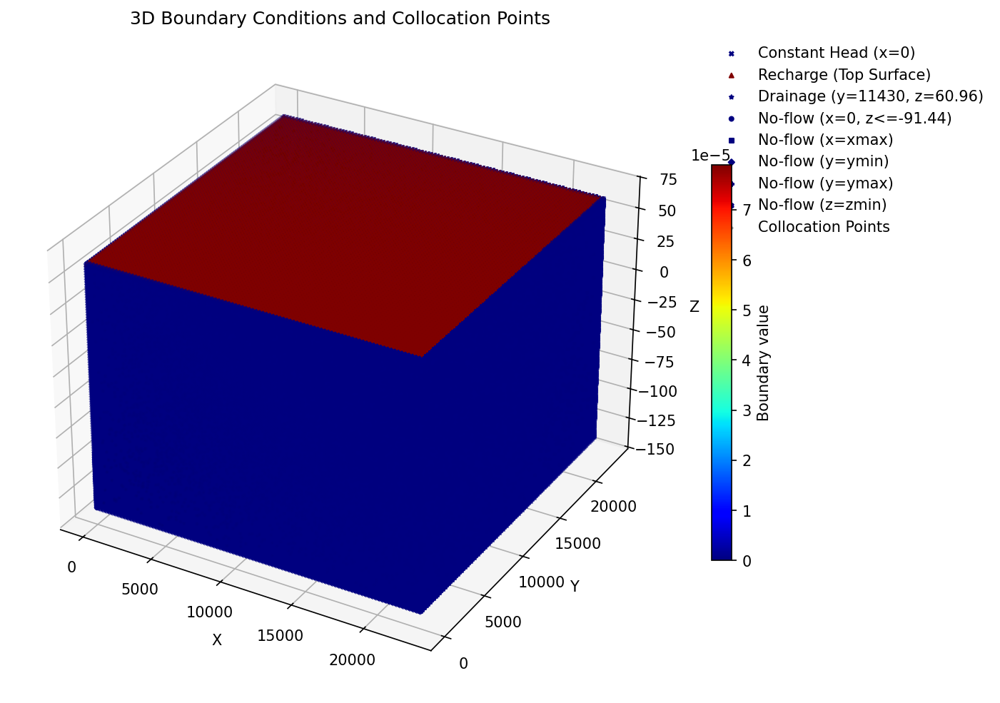

<Figure size 640x480 with 0 Axes>

In [ ]:
from mpl_toolkits.mplot3d import Axes3D  # 꼭 포함시켜야 함

def plot_3D_boundary_conditions(
    x_const, y_const, z_const, bc_const,
    x_re, y_re, z_re, bc_re,
    x_dr, y_dr, z_dr, q_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin,
    x_nf_x, y_nf_x, z_nf_x, bc_nf_x,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin,
    x_c, y_c, z_c
):
    fig = plt.figure(figsize=(10, 8), dpi=150)
    ax = fig.add_subplot(111, projection='3d')

    # 모든 bc 값을 모아서 color range 설정
    all_bc_values = jnp.concatenate([
        bc_const, bc_re, q_dr,
        bc_nf_xmin, bc_nf_x, bc_nf_ymin, bc_nf_ymax, bc_nf_zmin
    ])
    vmin, vmax = all_bc_values.min(), all_bc_values.max()

    # Scatter plot settings
    s = 8  # Point size
    alpha = 0.8  # Transparency

    # Plot each boundary condition separately
    scatter1 = ax.scatter(x_const, y_const, z_const, c=bc_const, marker='x', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Constant Head (x=0)')

    ax.scatter(x_re, y_re, z_re, c=bc_re, marker='^', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Recharge (Top Surface)')

    ax.scatter(x_dr, y_dr, z_dr, c=q_dr, marker='*', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='Drainage (y=11430, z=60.96)')

    ax.scatter(x_nf_xmin, y_nf_xmin, z_nf_xmin, c=bc_nf_xmin, marker='o', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (x=0, z<=-91.44)')

    ax.scatter(x_nf_x, y_nf_x, z_nf_x, c=bc_nf_x, marker='s', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (x=xmax)')
    ax.scatter(x_nf_ymin, y_nf_ymin, z_nf_ymin, c=bc_nf_ymin, marker='D', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (y=ymin)')
    ax.scatter(x_nf_ymax, y_nf_ymax, z_nf_ymax, c=bc_nf_ymax, marker='P', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (y=ymax)')
    ax.scatter(x_nf_zmin, y_nf_zmin, z_nf_zmin, c=bc_nf_zmin, marker='X', cmap=cm.jet, vmin=vmin, vmax=vmax, s=s, label='No-flow (z=zmin)')

    # Plot collocation points (small black dots)

    ax.scatter(x_c, y_c, z_c, c='k', marker='.', alpha=0.3, s=5, label='Collocation Points')

    # Labels and title
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('3D Boundary Conditions and Collocation Points')

    # Colorbar
    cbar = fig.colorbar(scatter1, ax=ax, shrink=0.6, aspect=20)
    cbar.set_label('Boundary value')

    # Legend
    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1), frameon=False)

    plt.show()  # 플롯을 화면에 표시
    plt.tight_layout()  # 레이아웃을 자동으로 조정

plot_3D_boundary_conditions(
    x_const, y_const, z_const, bc_const,
    x_re, y_re, z_re, bc_re,
    x_dr, y_dr, z_dr,  q_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin,
    x_c, y_c, z_c
)


In [ ]:
def pde_residual_3d_darcy(xyz, h):
    """
    Compute the PDE residual for 3D Darcy's groundwater flow in heterogeneous media.
    """
    xyz = xyz.reshape(-1, 3)
    x, y, z = xyz[:, 0:1], xyz[:, 1:2], xyz[:, 2:3]

    K_x, K_y, K_z = hydraulic_conductivity(x, y, z)

    # Compute gradients (First-order derivatives) of the neural network output (h)
    h_grad = vmap(jacfwd(h))(xyz)

    h_x, h_y, h_z = h_grad[:, 0], h_grad[:, 1], h_grad[:, 2]

    # Compute second derivatives
    def h_x_fn(xyz_):
        return jacfwd(h)(xyz_)[0]

    def h_y_fn(xyz_):
        return jacfwd(h)(xyz_)[1]

    def h_z_fn(xyz_):
        return jacfwd(h)(xyz_)[2]

    h_xx = vmap(jacfwd(h_x_fn))(xyz)
    h_yy = vmap(jacfwd(h_y_fn))(xyz)
    h_zz = vmap(jacfwd(h_z_fn))(xyz)

    # Divergence of flux (∇·q)
    div_q = -(K_x * h_xx[:, 0] + K_y * h_yy[:, 1] + K_z * h_zz[:, 2])

    pde_res = div_q.reshape(-1, 1)
    return pde_res

In [ ]:
# Generate 3D grid for visualization
nx, ny, nz = 20, 20, 20
x = np.linspace(xmin, xmax, nx)
y = np.linspace(ymin, ymax, ny)
z = np.linspace(zmin, zmax, nz)
X, Y, Z = np.meshgrid(x, y, z, indexing='ij')
xyz_points = np.vstack([X.ravel(), Y.ravel(), Z.ravel()]).T  # Shape (nx*ny*nz, 3)

In [ ]:
# Define the Neural Network Architecture
def neural_net(params, xyz):
    """
    Forward pass through the neural network.
    """
    for w, b in params:
        h_nn = jnp.dot(xyz, w) + b
        xyz = jnp.tanh(h_nn)  # Activation function
    return h_nn.reshape(-1, 1)

In [ ]:
def init_mlp(layers, key):
    """
    Initialize the neural network using Xavier initialization.

    Args:
        layers: List defining the number of nodes in each layer (e.g., [1, 50, 50, 1]).
        key: Random key for initialization.

    Returns:
        params: Initialized weights and biases for the network.
    """
    params = []
    for i in range(len(layers) - 1):
        key, subkey = random.split(key)
        bound = jnp.sqrt(6. / (layers[i] + layers[i+1]))
        weights = random.uniform(subkey, (layers[i], layers[i+1]), minval=-bound, maxval=bound)
        biases = jnp.zeros(layers[i+1])
        params.append((weights, biases))
    return params

In [ ]:
def pde_recharge_3d_darcy(xyz, params):
    def h_single(xyz_single):
        return neural_net(params, xyz_single.reshape(1, -1))[0, 0]

    xyz = xyz.reshape(-1, 3)

    K_x, K_y, K_z = hydraulic_conductivity(xyz[:, 0:1], xyz[:, 1:2], xyz[:, 2:3])

    h_grad_fn = lambda xyz_: jacfwd(h_single)(xyz_)  # Single input
    h_grad = vmap(h_grad_fn)(xyz)                    # Vmap over all xyz points

    h_z = h_grad[:, 2]  # z 방향 미분만
    qz = -K_z.flatten() * h_z

    return qz.reshape(-1, 1)

In [ ]:
def loss_func(params, colloc, conds, colloc_h_init):
    """
    Computes the total loss for the 3D Darcy PINN model with Face-specific boundary conditions.
    """
    def h(xyz):
        return neural_net(params, xyz)

    # 단일 포인트 input을 위한 h_single 함수 정의
    def h_single(xyz_single):
        xyz_single = xyz_single.reshape(1, -1)  # (1,3)
        return neural_net(params, xyz_single)[0, 0]

    # 1. PDE Residual Loss (colloc points에서)
    pde_res = pde_residual_3d_darcy(colloc, h_single).reshape(-1, 1)
    pde_loss = jnp.mean(jnp.nan_to_num((pde_res) ** 2, nan=1e6, posinf=1e6, neginf=1e6))

    # 2. Dirichlet BC Loss (BC_const = conds[0])
    dbc_loss = 0
    for cond in [conds[0]]:  # Constant head
        x_b, y_b, z_b, h_b = cond[:, [0]], cond[:, [1]], cond[:, [2]], cond[:, [3]]
        bc_xyz = jnp.hstack([x_b, y_b, z_b])
        dbc_loss += jnp.mean((h(bc_xyz) - h_b) ** 2)

    # 3. Recharge BC Loss (BC_re = conds[1])
    pde_re_res = pde_recharge_3d_darcy(conds[1][:, :3], params)
    re_loss = jnp.mean((pde_re_res + conds[1][:, 3:]) ** 2)

    # 4. Neumann BC Losses
    # 방향별 미분 함수 (vmap 적용된 버전)
    dh_dx = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[0])(xyz)
    dh_dy = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[1])(xyz)
    dh_dz = lambda xyz: vmap(lambda x: jacfwd(h_single)(x)[2])(xyz)

    # 4-1. Drainage BC (BC_dr = conds[2])
    bc_xyz = conds[2][:, :3]
    x_drain = bc_xyz[:, 0:1]
    h_pred = h(bc_xyz)

    # Darcy 유량 예측
    h_grad_z = dh_dz(bc_xyz)
    K_x, K_y, K_z = hydraulic_conductivity(bc_xyz[:, 0:1], bc_xyz[:, 1:2], bc_xyz[:, 2:3])
    q_predicted = -K_z * h_grad_z

    # 기대 Drain 유량
    q_dr_expected = drain_discharge(h_pred, x_drain)
    drain_loss = jnp.mean((q_predicted - q_dr_expected) ** 2)

    # 4-2. No-flow BCs
    nf_x_loss = 0.0
    for cond in [conds[3], conds[4]]:  # x=xmin, x=xmax
        bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
        nf_x_loss += jnp.mean((dh_dx(bc_xyz) - bc_grad) ** 2)

    nf_y_loss = 0.0
    for cond in [conds[5], conds[6]]:  # y=ymin, y=ymax
        bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
        nf_y_loss += jnp.mean((dh_dy(bc_xyz) - bc_grad) ** 2)

    nf_z_loss = 0.0
    cond = conds[7]  # z=zmin
    bc_xyz, bc_grad = cond[:, :3], cond[:, [3]]
    nf_z_loss += jnp.mean((dh_dz(bc_xyz) - bc_grad) ** 2)

    # 5. (Optional) Soft constraint (지금은 주석처리)
    min_violation = jnp.mean(jnp.maximum(0, -h(colloc).squeeze()) ** 2)

    # Total Loss
    total_loss = 1*pde_loss + 50*dbc_loss + 50*re_loss + 20*drain_loss + 10*(nf_x_loss + nf_y_loss + nf_z_loss) + 5*min_violation

    return jnp.sum(total_loss)


In [ ]:
colloc_h_init = jnp.zeros((colloc.shape[0],1))
print(colloc_h_init)

[[0.]
 [0.]
 [0.]
 ...
 [0.]
 [0.]
 [0.]]


✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 0: Loss = 7.9570e+00
Epoch 0: Loss = 7.9570e+00


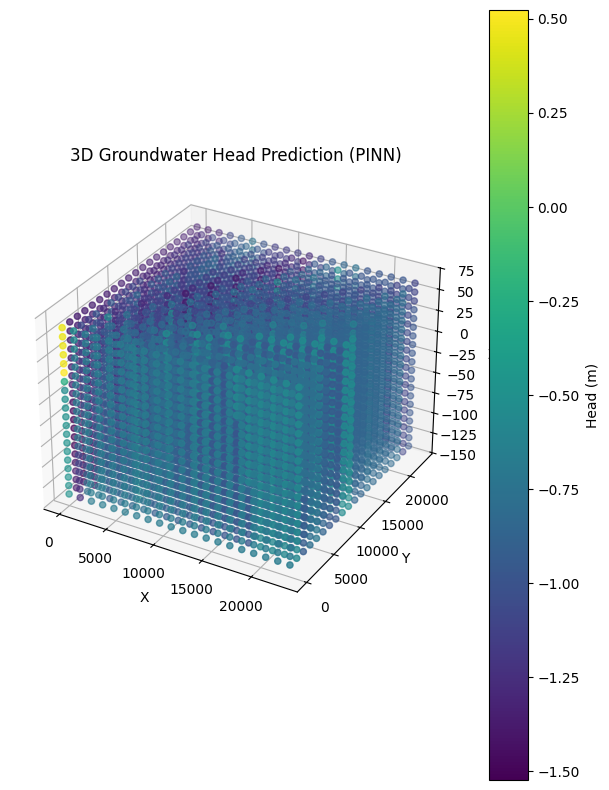

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 10: Loss = 1.4549e+01
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 20: Loss = 2.5542e-01
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 30: Loss = 5.3996e-01
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 40: Loss = 5.3348e-01
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 50: Loss = 8.7483e-02
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 60: Loss = 1.0020e-02
Epoch 70: Loss = 2.6198e-02
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 80: Loss = 7.6300e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 90: Loss = 3.7421e-03
✅ Paramete

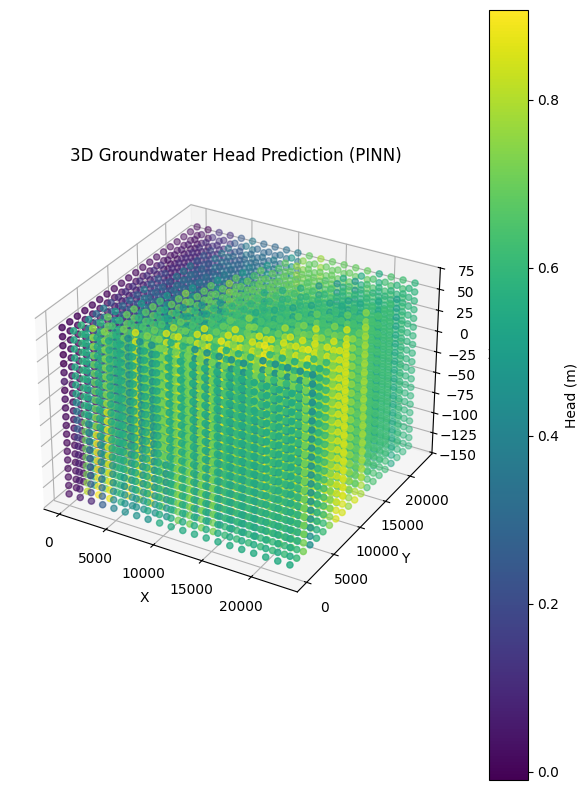

Epoch 110: Loss = 9.1447e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 120: Loss = 5.2686e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 130: Loss = 4.9328e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 140: Loss = 4.7525e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_so

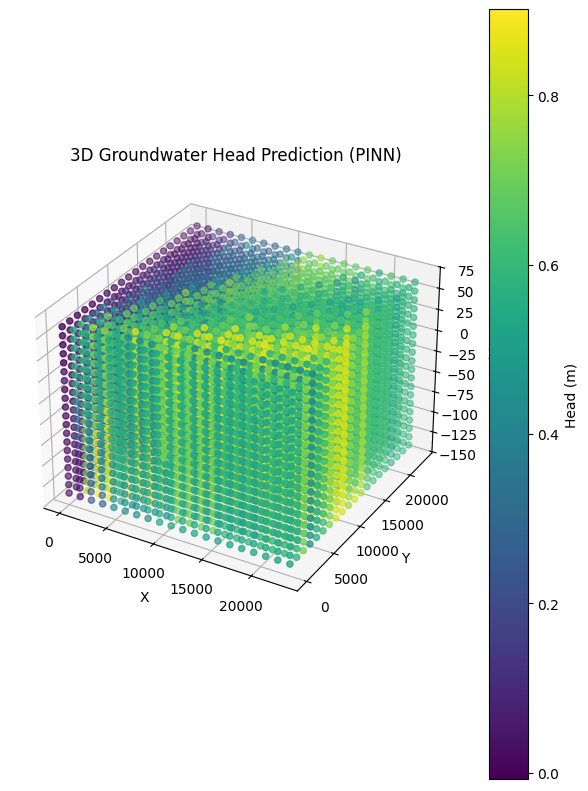

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 210: Loss = 3.3086e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

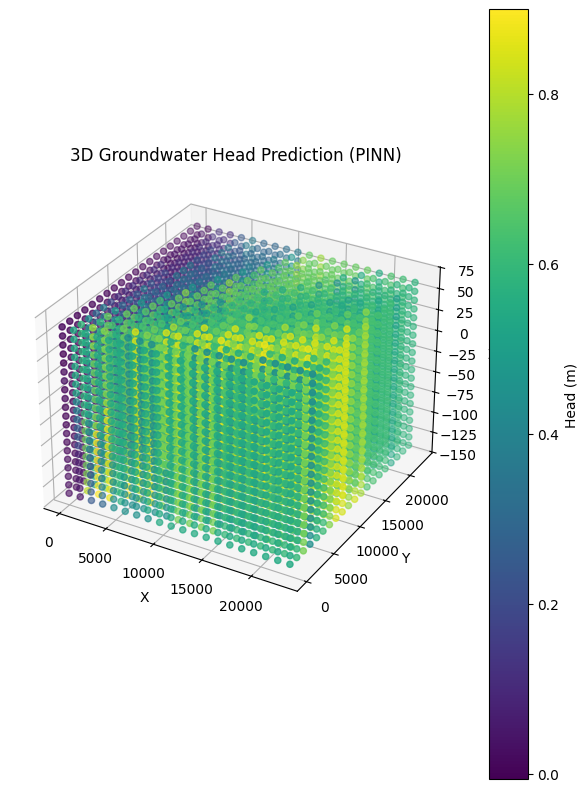

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 310: Loss = 2.4894e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

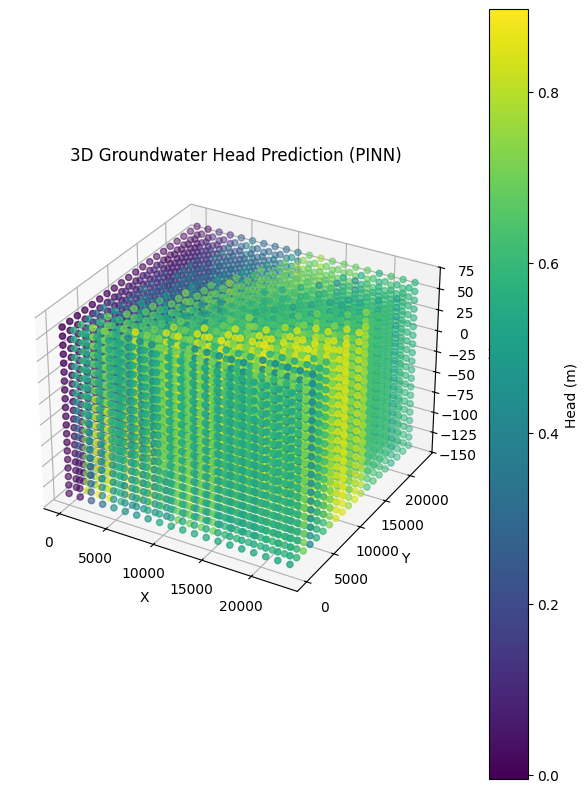

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 410: Loss = 2.0781e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

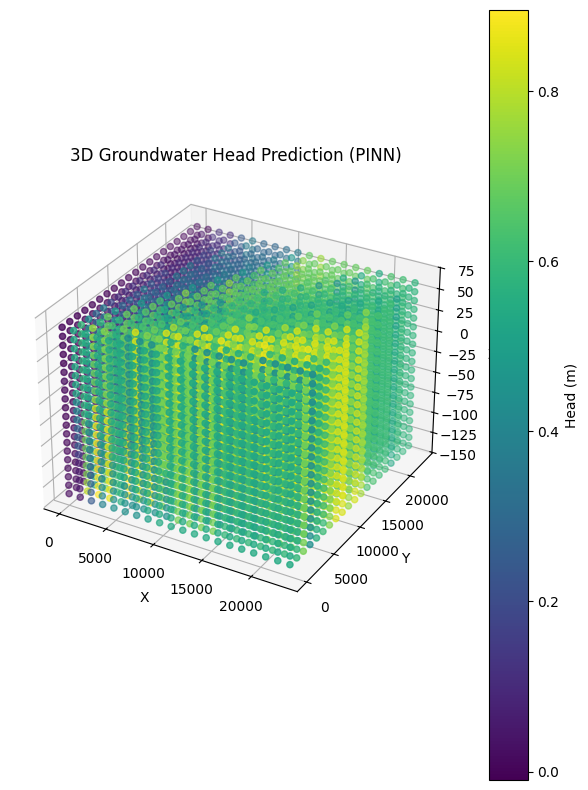

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 510: Loss = 1.8868e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

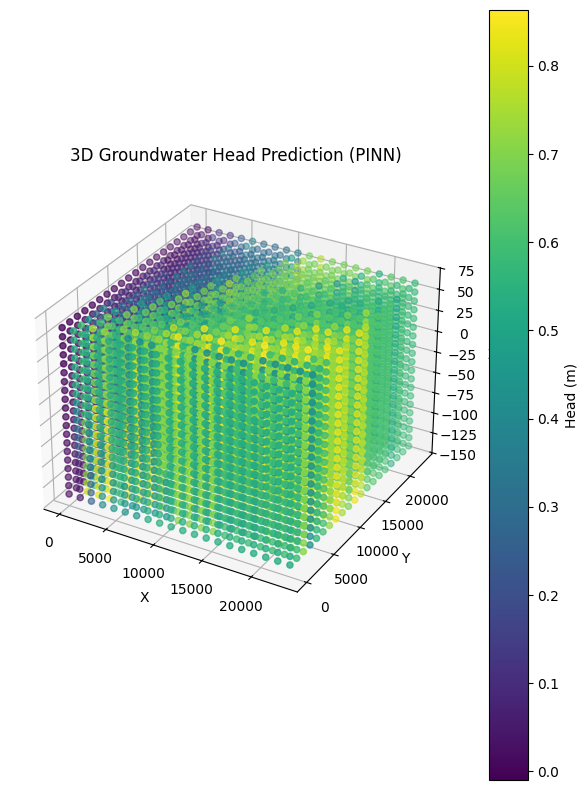

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 610: Loss = 1.7842e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

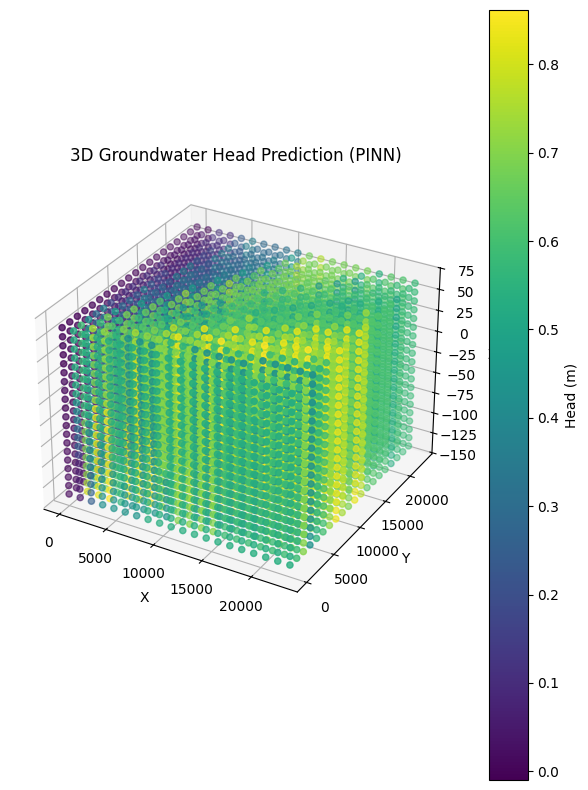

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 710: Loss = 1.6896e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softcon

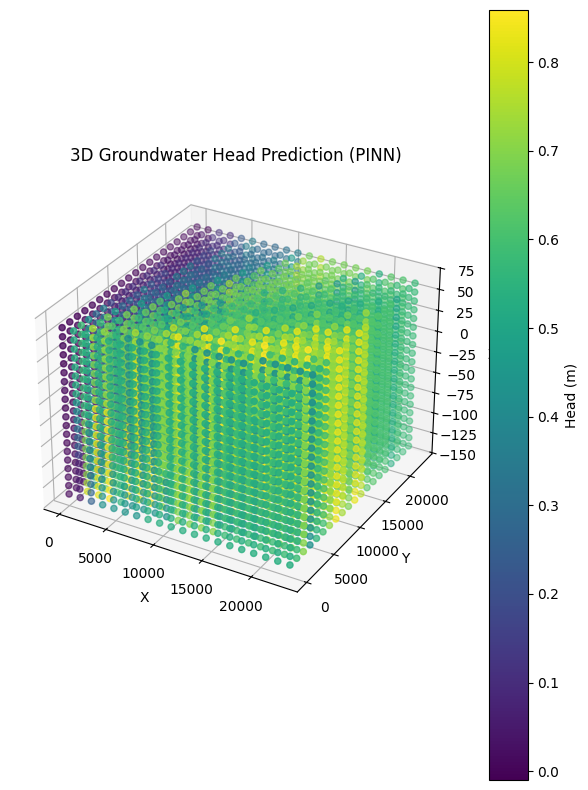

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 810: Loss = 1.6262e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 820: Loss = 1.6207e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyD

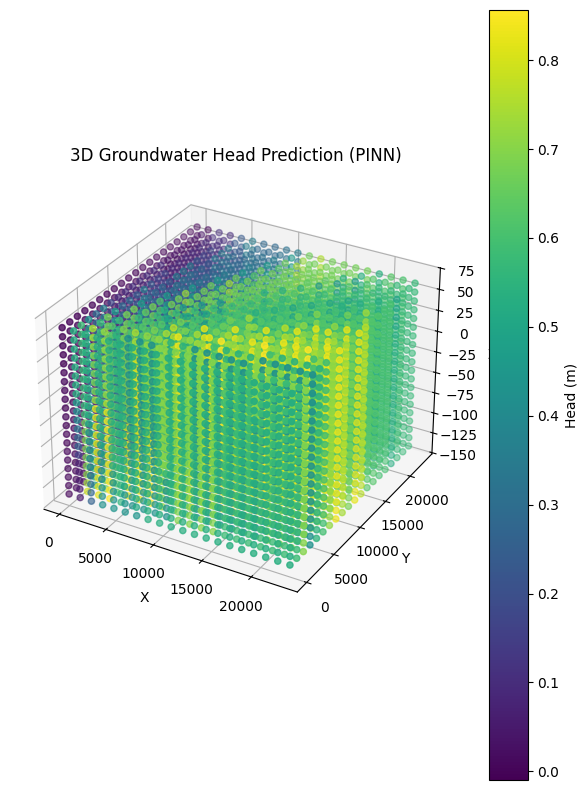

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 910: Loss = 1.5727e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 920: Loss = 1.5495e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 930: Loss = 1.5681e-04
✅ Parameter

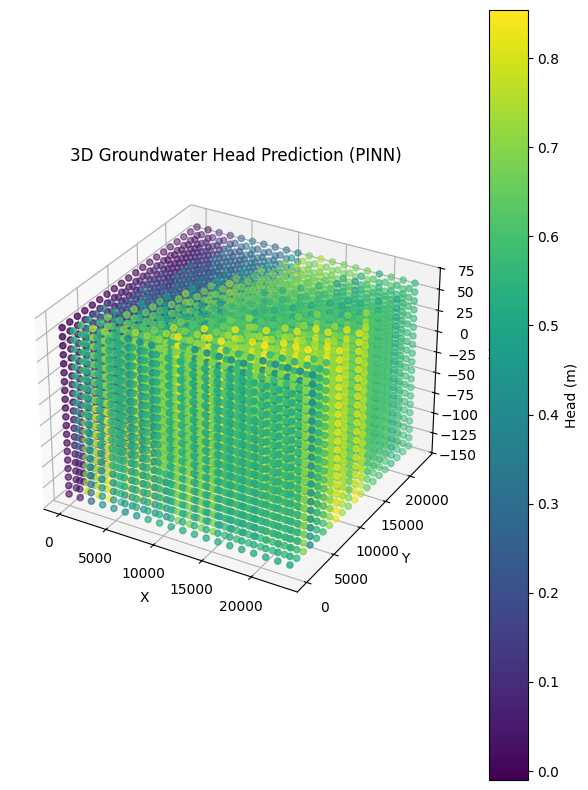

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1010: Loss = 1.5060e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softco

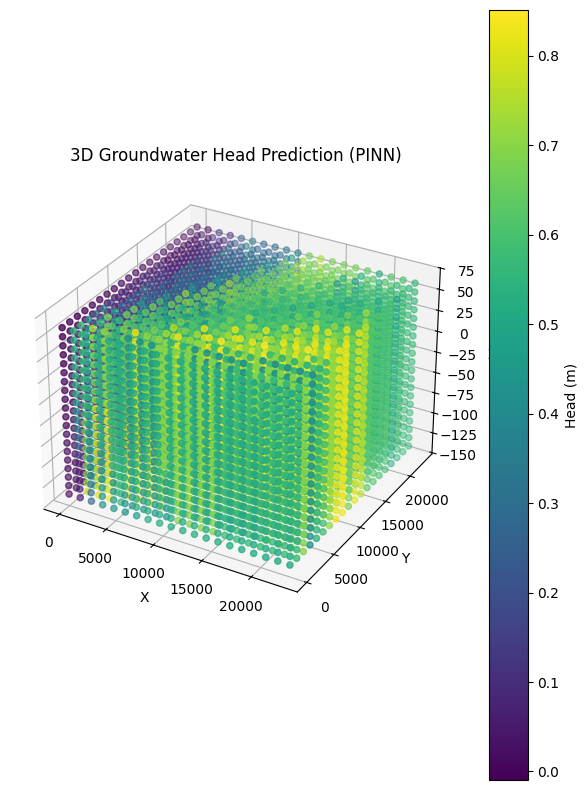

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1110: Loss = 1.5054e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1120: Loss = 1.4417e-04
Epoch 1130: Loss = 1.4548e-04
Epoch 1140: Loss = 1.4632e-04
Epoch 1150: Loss = 1.4435e-04
Epoch 1160: Loss = 1.4462e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1170: Loss = 1.4329e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1180: Loss = 1.4238e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at 

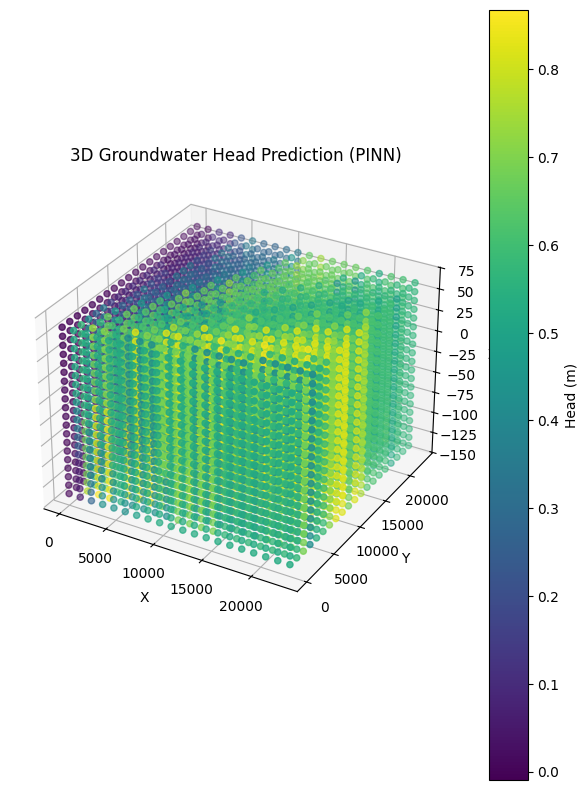

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1210: Loss = 1.4020e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1220: Loss = 1.3830e-04
Epoch 1230: Loss = 1.3866e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 12

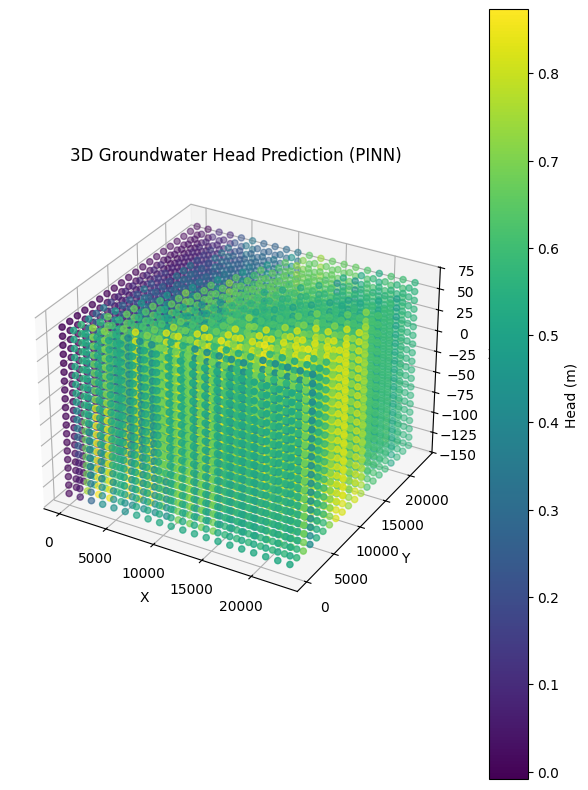

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1310: Loss = 1.3326e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1320: Loss = 1.3251e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

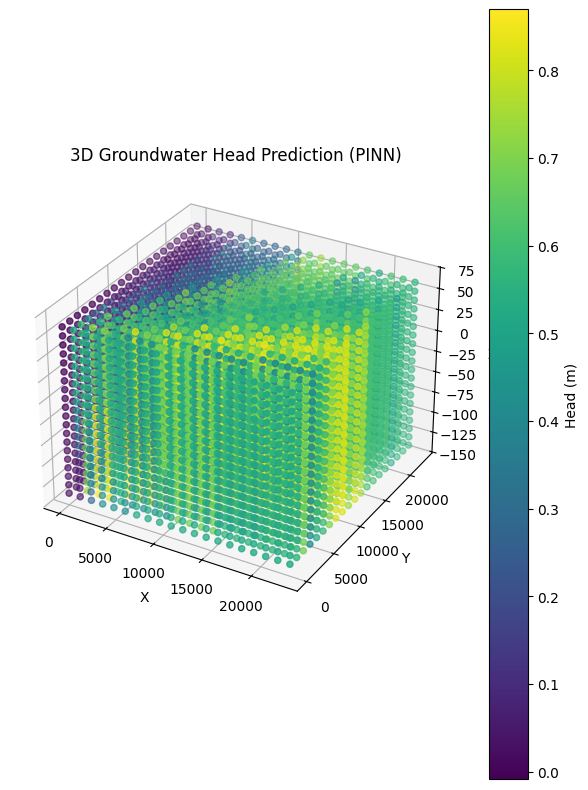

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1410: Loss = 1.2724e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1420: Loss = 1.2650e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

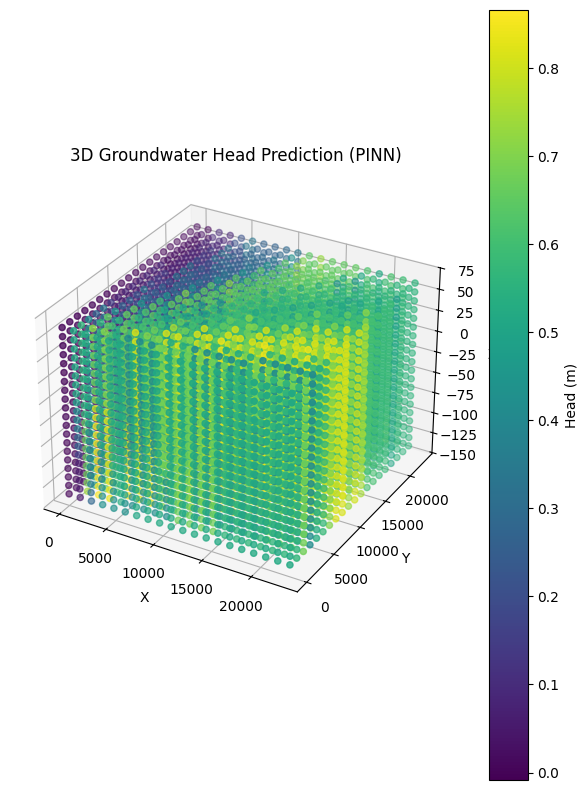

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1510: Loss = 1.2151e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1520: Loss = 1.2101e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

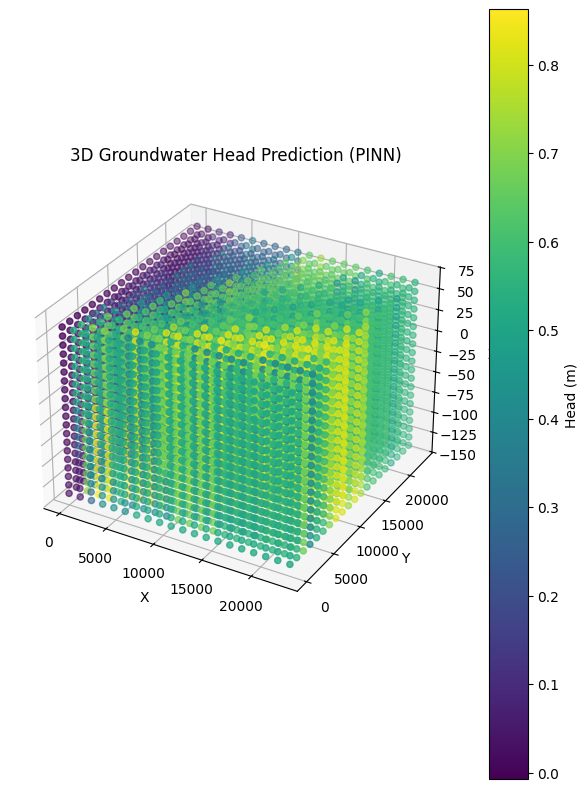

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1610: Loss = 1.1575e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1620: Loss = 1.1536e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

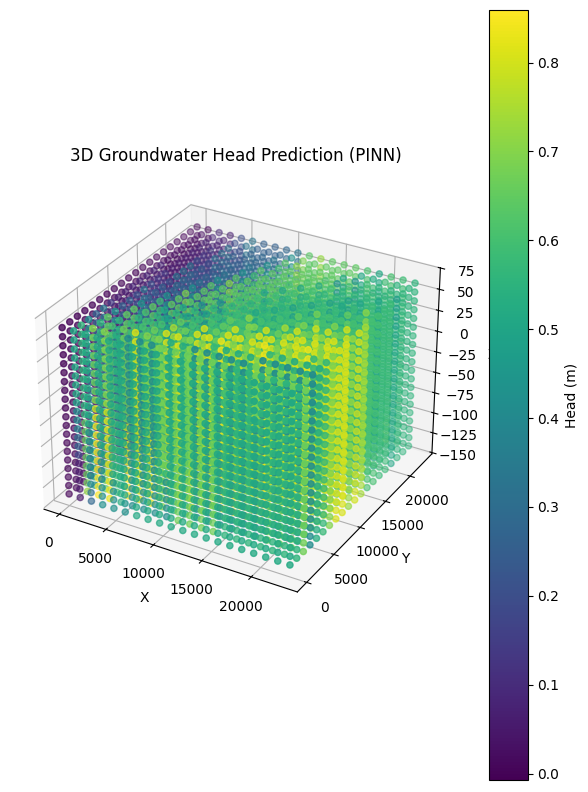

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1710: Loss = 1.0925e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1720: Loss = 1.0801e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

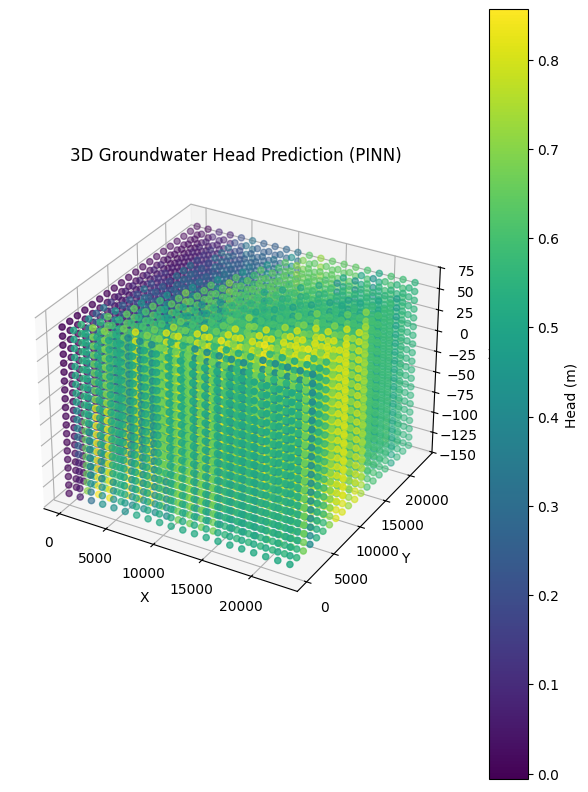

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1810: Loss = 1.0258e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1820: Loss = 1.0177e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

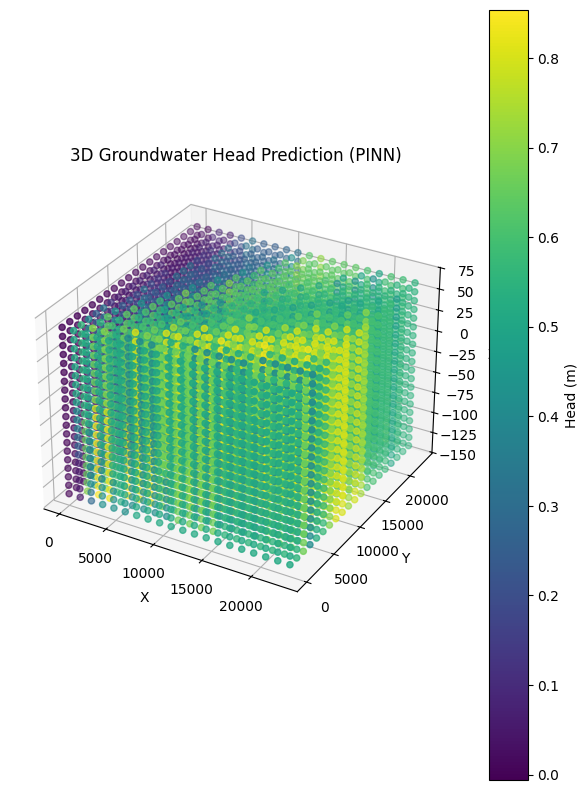

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1910: Loss = 9.8174e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 1920: Loss = 9.7774e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

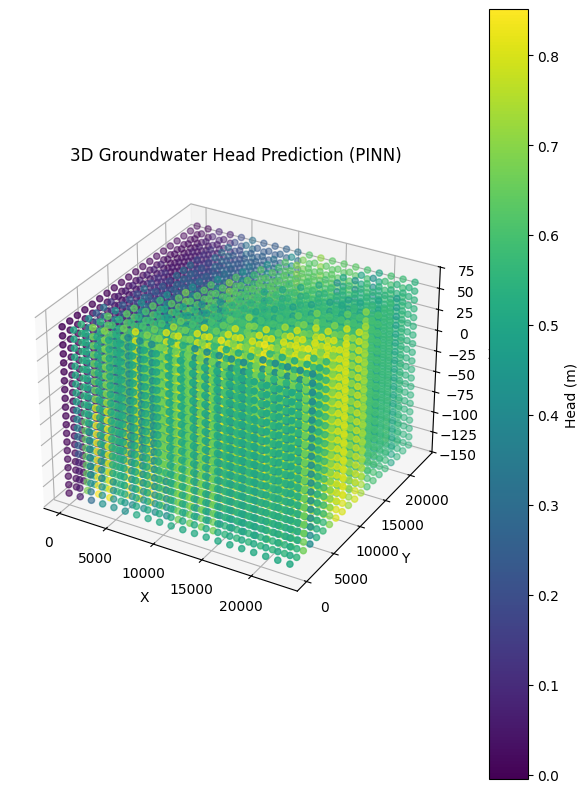

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2010: Loss = 9.3873e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2020: Loss = 9.3706e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2030: Loss = 9.2737e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parame

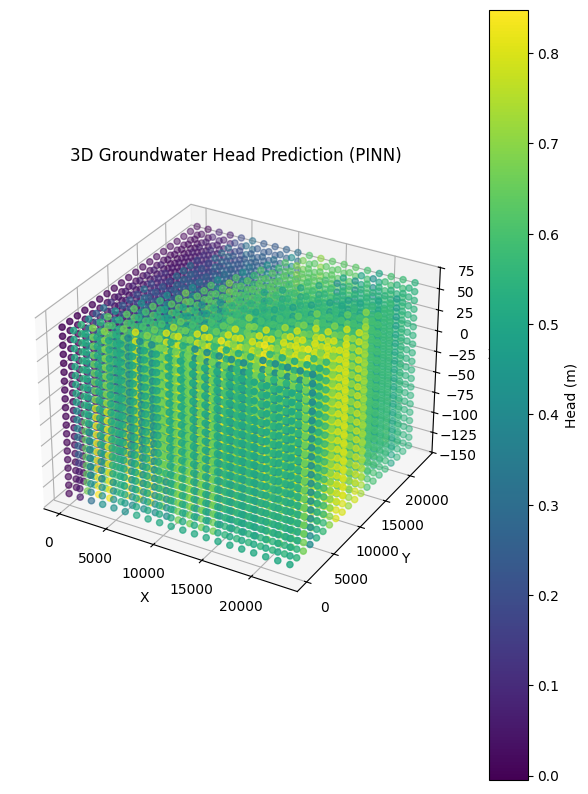

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2110: Loss = 8.9475e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2120: Loss = 8.8486e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2130: Loss = 8.7456e-05
Epoch 2140: Loss = 8.6791e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2150: Loss = 8.6329e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content

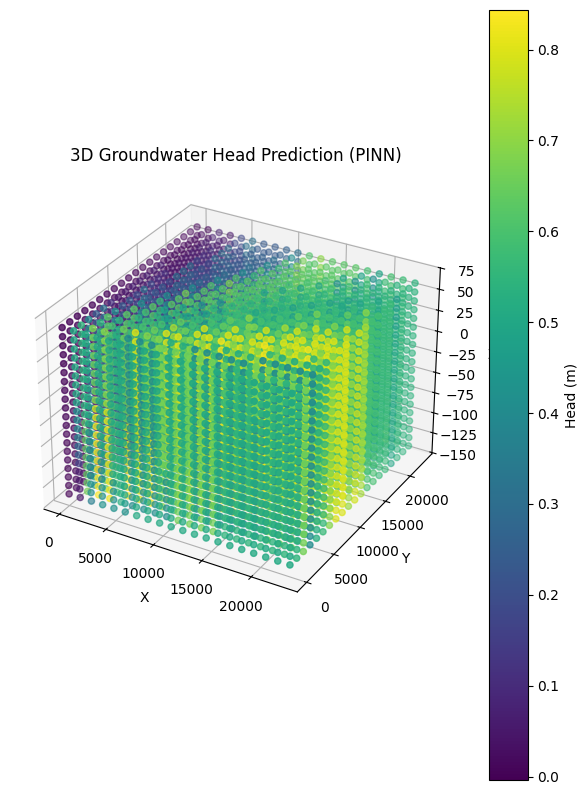

Epoch 2210: Loss = 8.5866e-05
Epoch 2220: Loss = 8.6793e-05
Epoch 2230: Loss = 8.7382e-05
Epoch 2240: Loss = 8.7018e-05
Epoch 2250: Loss = 8.6763e-05
Epoch 2260: Loss = 8.4611e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2270: Loss = 8.6654e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2280: Loss = 8.3593e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2290: Loss = 8.2940e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2300.pkl


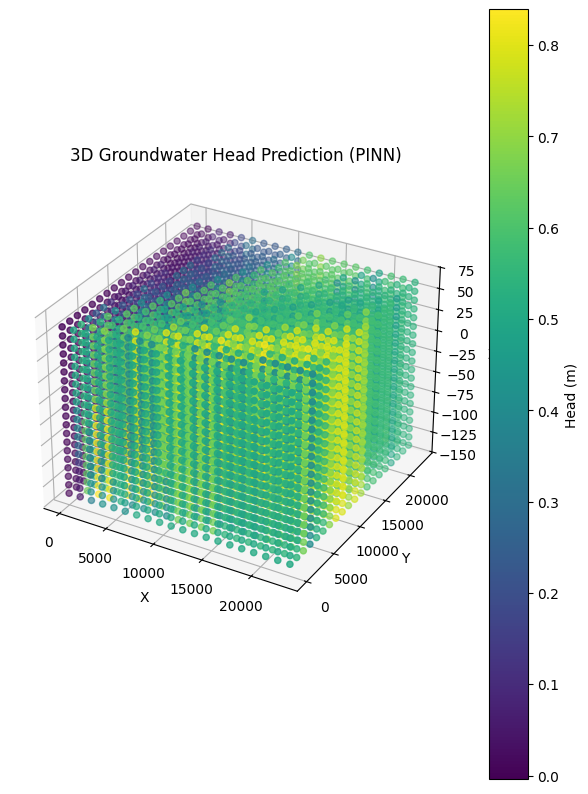

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2310: Loss = 8.2870e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2320: Loss = 8.2430e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2330: Loss = 8.1483e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2340: Loss = 8.0617e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_042

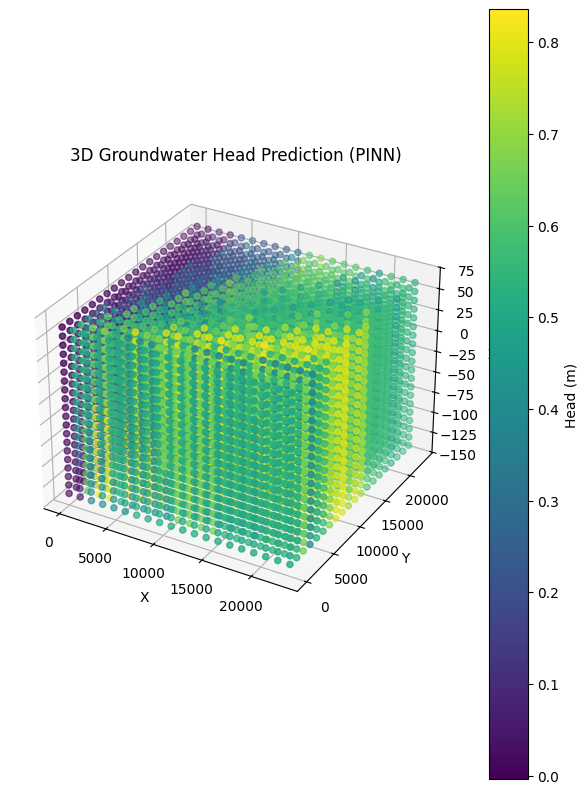

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2410: Loss = 7.6849e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2420: Loss = 7.7232e-05
Epoch 2430: Loss = 7.7429e-05
Epoch 2440: Loss = 7.6931e-05
Epoch 2450: Loss = 7.6575e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2460: Loss = 7.6118e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl


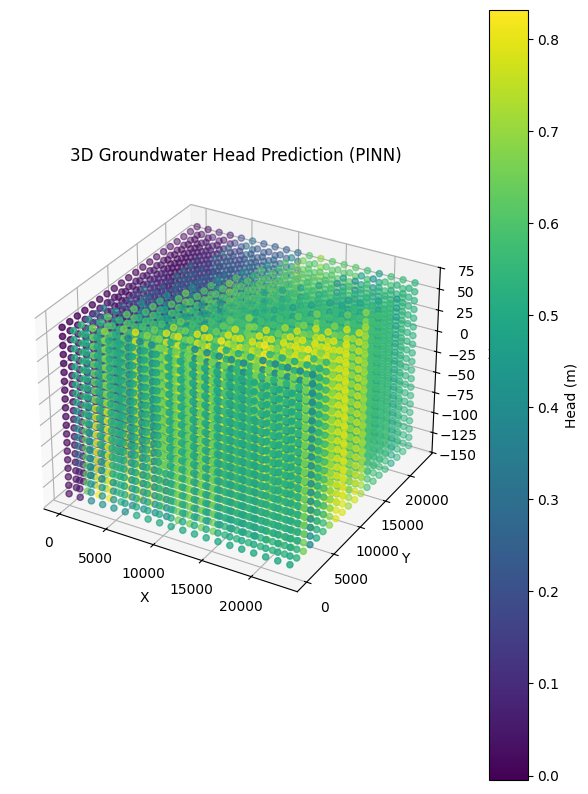

Epoch 2510: Loss = 7.8515e-05
Epoch 2520: Loss = 7.9159e-05
Epoch 2530: Loss = 7.7830e-05
Epoch 2540: Loss = 7.8285e-05
Epoch 2550: Loss = 7.7173e-05
Epoch 2560: Loss = 7.6819e-05
Epoch 2570: Loss = 7.6383e-05
Epoch 2580: Loss = 7.6264e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2590: Loss = 7.5602e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2600.pkl
Epoch 2600: Loss = 7.4972e-05
Epoch 2600: Loss = 7.4972e-05


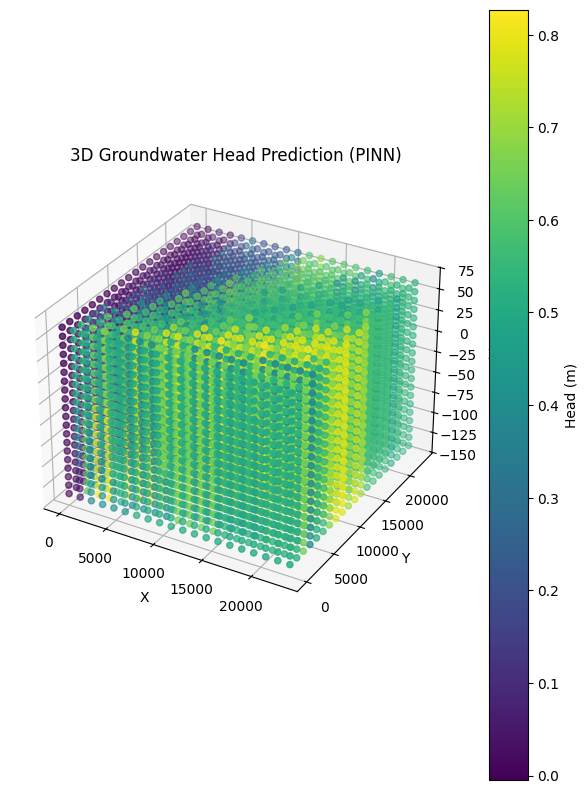

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2610: Loss = 7.4202e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2620: Loss = 7.2738e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

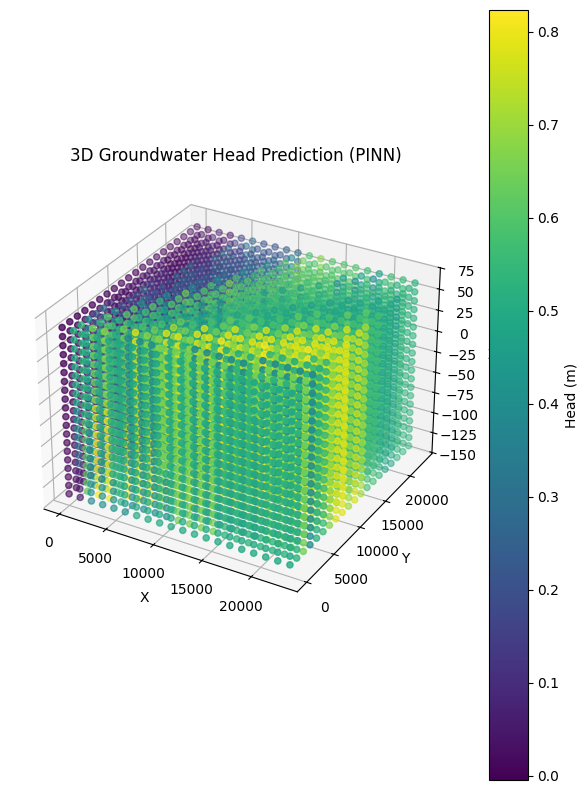

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2710: Loss = 7.3333e-05
Epoch 2720: Loss = 7.1183e-05
Epoch 2730: Loss = 7.1024e-05
Epoch 2740: Loss = 7.1886e-05
Epoch 2750: Loss = 7.3992e-05
Epoch 2760: Loss = 7.8401e-05
Epoch 2770: Loss = 7.4573e-05
Epoch 2780: Loss = 7.4333e-05
Epoch 2790: Loss = 7.5057e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2800.pkl
Epoch 2800: Loss = 7.4036e-05
Epoch 2800: Loss = 7.4036e-05


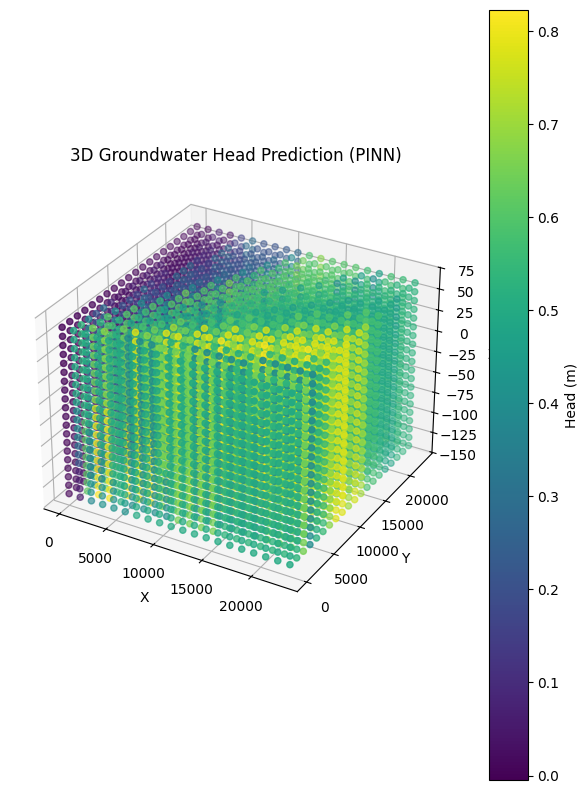

Epoch 2810: Loss = 7.4709e-05
Epoch 2820: Loss = 7.2636e-05
Epoch 2830: Loss = 7.2044e-05
Epoch 2840: Loss = 7.0201e-05
Epoch 2850: Loss = 6.9766e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2860: Loss = 6.9120e-05
Epoch 2870: Loss = 6.8621e-05
Epoch 2880: Loss = 6.7714e-05
Epoch 2890: Loss = 6.8175e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_2900.pkl
Epoch 2900: Loss = 6.7130e-05
Epoch 2900: Loss = 6.7130e-05


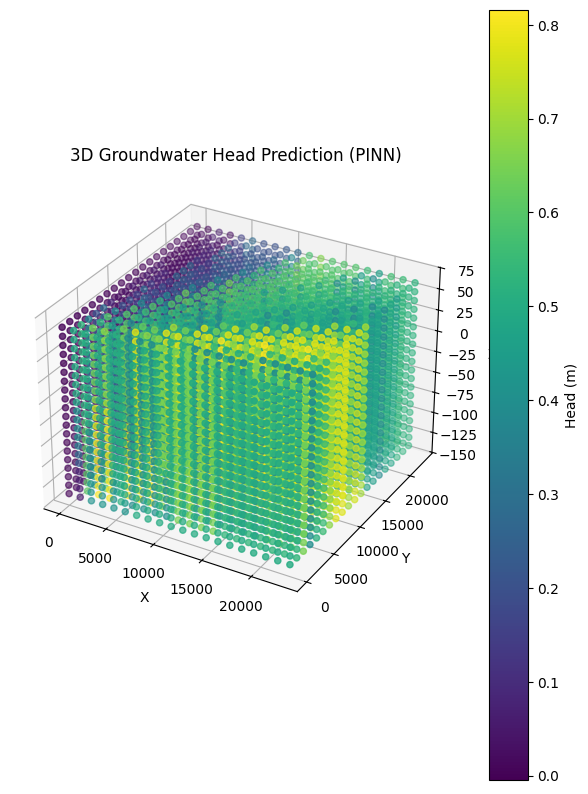

Epoch 2910: Loss = 6.7185e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2920: Loss = 6.7493e-05
Epoch 2930: Loss = 6.7156e-05
Epoch 2940: Loss = 6.7026e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2950: Loss = 6.7055e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2960: Loss = 7.3830e-05
Epoch 2970: Loss = 6.7546e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 2980: Loss = 6.5084e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at 

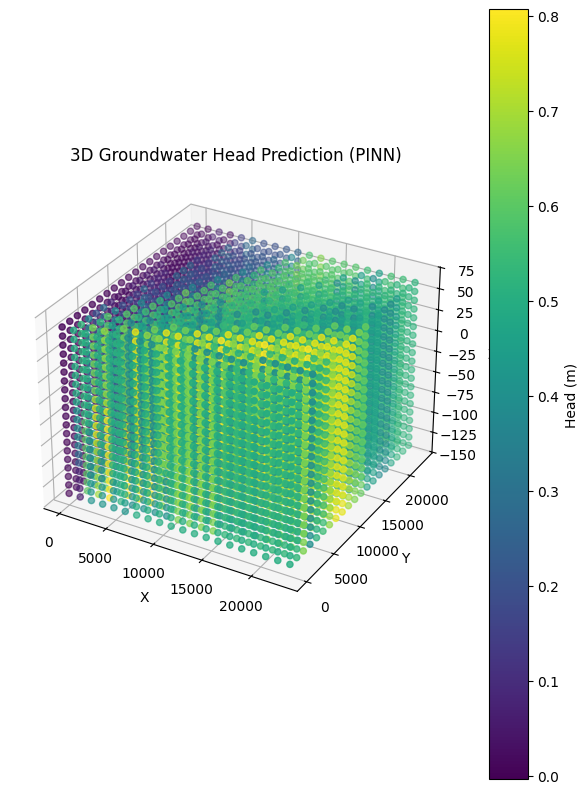

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3010: Loss = 6.4219e-05
Epoch 3020: Loss = 6.7386e-05
Epoch 3030: Loss = 6.6317e-05
Epoch 3040: Loss = 6.8914e-05
Epoch 3050: Loss = 6.9340e-05
Epoch 3060: Loss = 6.8538e-05
Epoch 3070: Loss = 6.7385e-05
Epoch 3080: Loss = 6.6175e-05
Epoch 3090: Loss = 6.5150e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3100.pkl
Epoch 3100: Loss = 6.3643e-05
Epoch 3100: Loss = 6.3643e-05


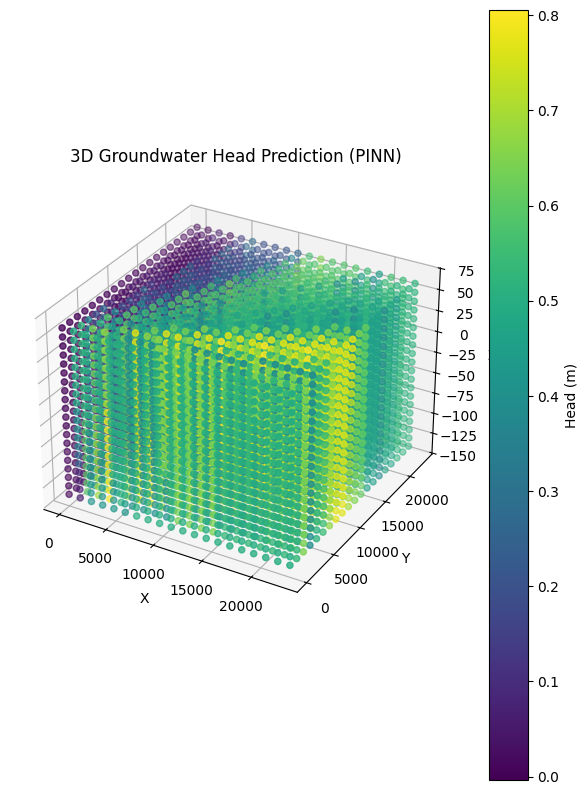

Epoch 3110: Loss = 6.3271e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3120: Loss = 6.1321e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3130: Loss = 6.0793e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3140: Loss = 5.9794e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3150: Loss = 5.8896e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3160: Loss = 5.8578e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl


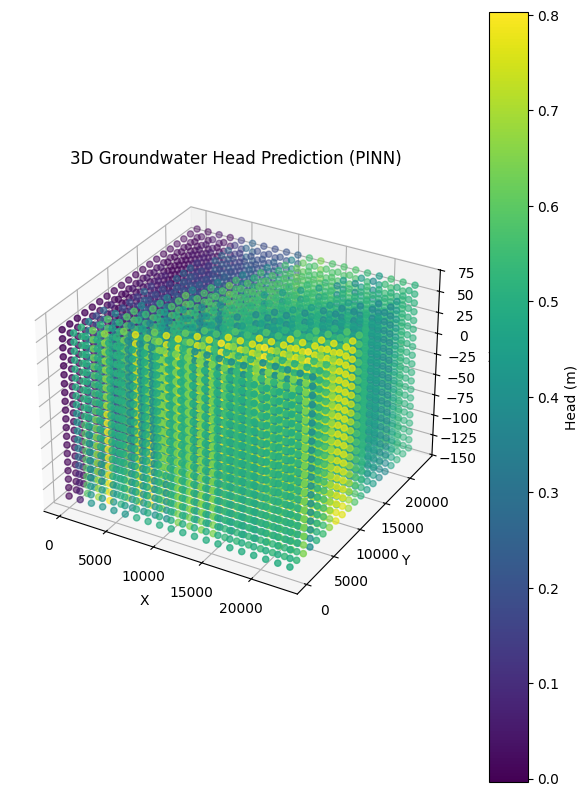

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3210: Loss = 5.6244e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3220: Loss = 5.6570e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3230: Loss = 5.5786e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 32

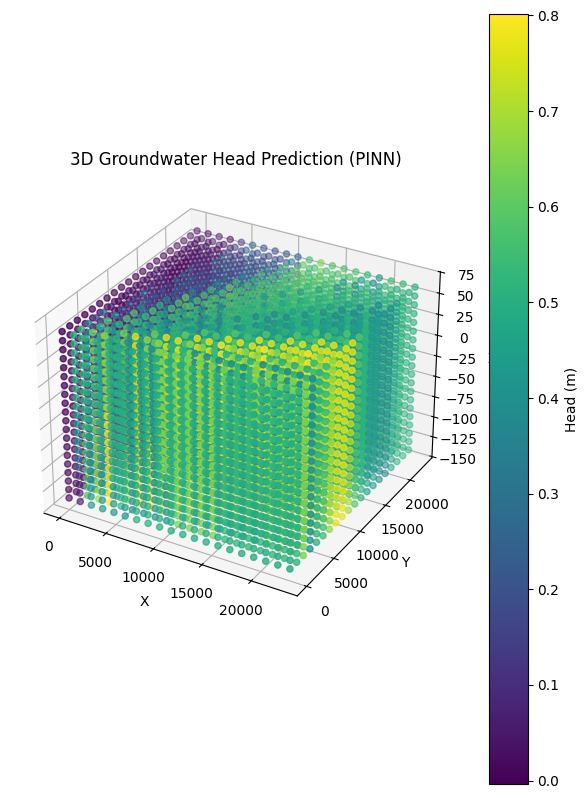

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3310: Loss = 5.7203e-05
Epoch 3320: Loss = 5.7163e-05
Epoch 3330: Loss = 5.8632e-05
Epoch 3340: Loss = 5.8356e-05
Epoch 3350: Loss = 5.8434e-05
Epoch 3360: Loss = 6.0770e-05
Epoch 3370: Loss = 5.8103e-05
Epoch 3380: Loss = 5.6786e-05
Epoch 3390: Loss = 5.7024e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_3400.pkl
Epoch 3400: Loss = 5.3757e-05
Epoch 3400: Loss = 5.3757e-05


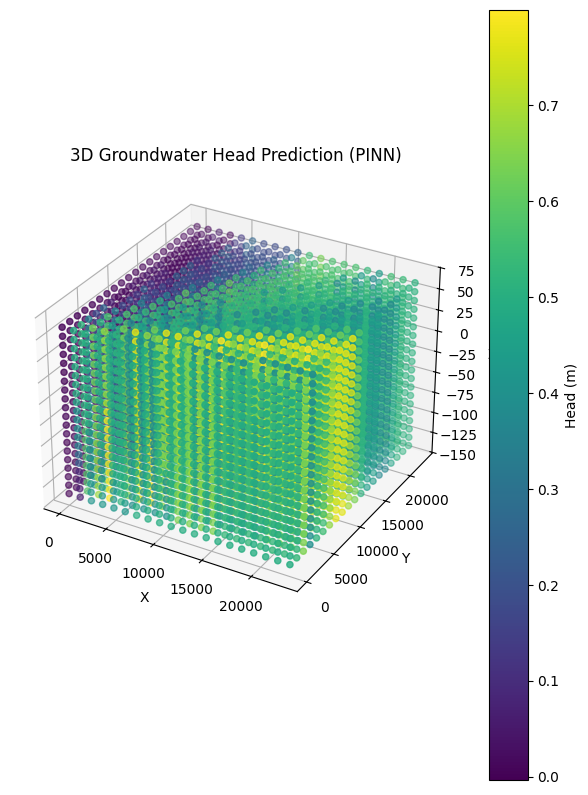

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3410: Loss = 5.3477e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3420: Loss = 5.2867e-05
Epoch 3430: Loss = 5.2939e-05
Epoch 3440: Loss = 5.3334e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3450: Loss = 5.2172e-05
✅ Parameters saved at /content

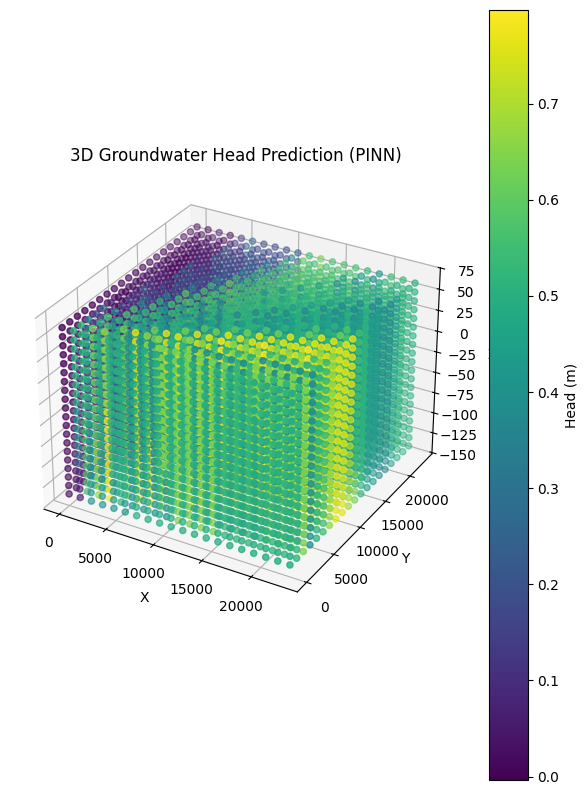

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3510: Loss = 5.1114e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3520: Loss = 5.1191e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

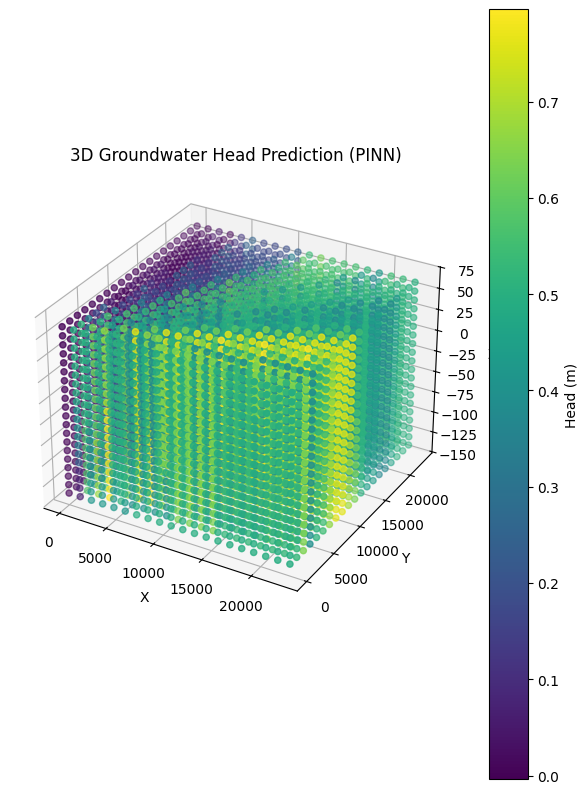

Epoch 3610: Loss = 5.6031e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3620: Loss = 4.9572e-05
Epoch 3630: Loss = 5.9662e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3640: Loss = 5.0192e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3650: Loss = 4.8923e-05
Epoch 3660: Loss = 5.3265e-05


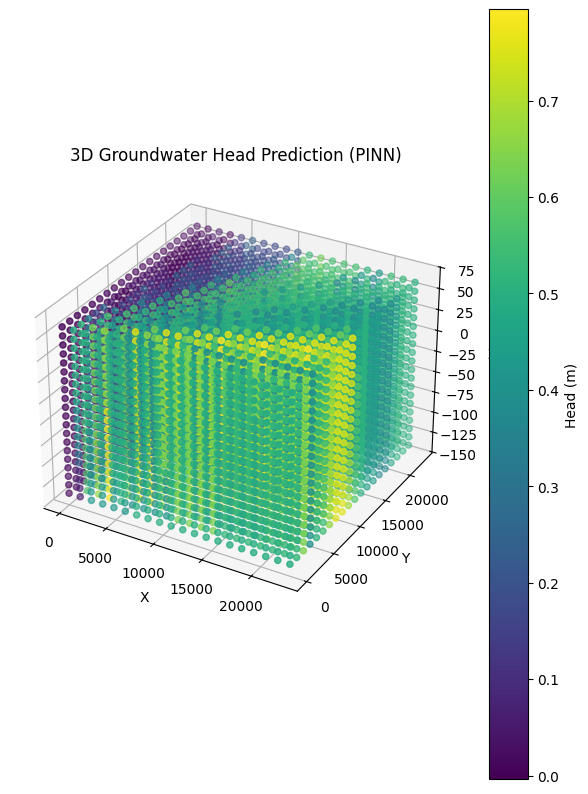

Epoch 3710: Loss = 4.9259e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3720: Loss = 4.7945e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3730: Loss = 4.7579e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 37

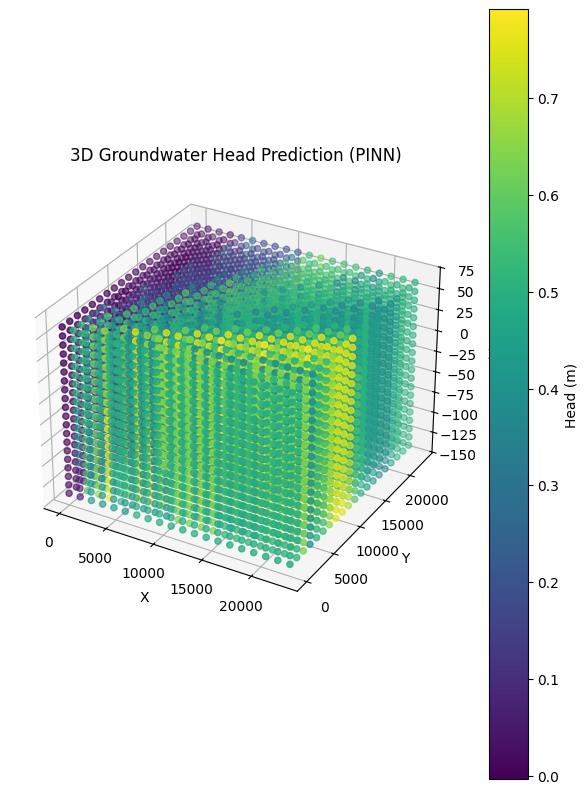

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3810: Loss = 4.7742e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3820: Loss = 4.6044e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3830: Loss = 4.6508e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3840: Loss = 4.5735e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3850: Loss = 4.6471e-05
Epoch 3860: Loss = 4.6269e-05


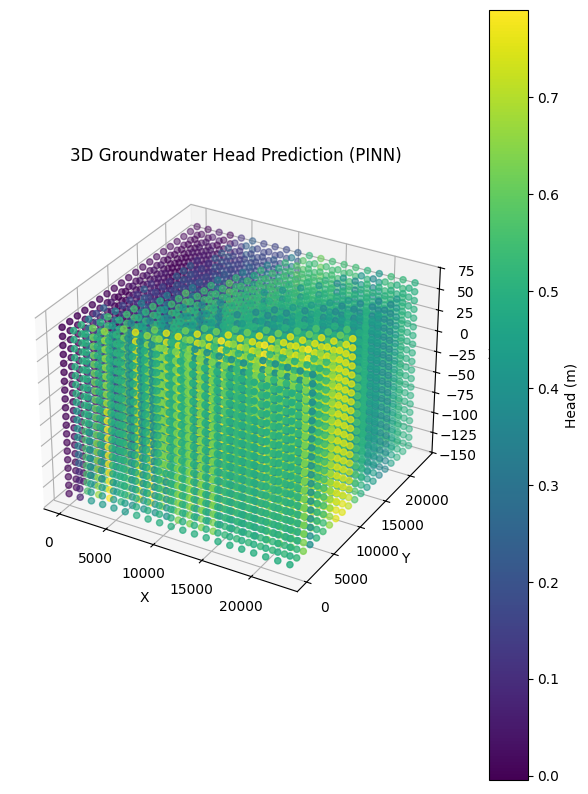

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3910: Loss = 4.5149e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3920: Loss = 4.4972e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3930: Loss = 4.4760e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 3940: Loss = 4.4672e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_042

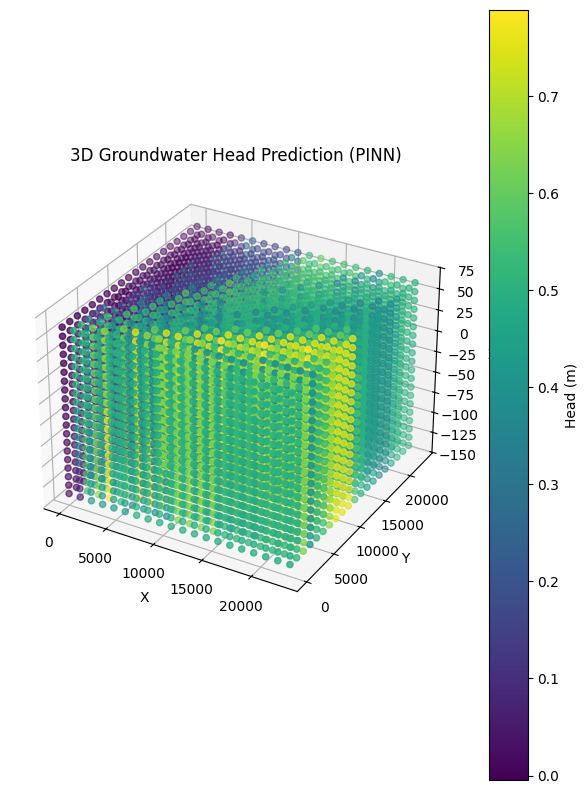

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4010: Loss = 5.0663e-05
Epoch 4020: Loss = 4.7648e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4030: Loss = 4.6179e-05
Epoch 4040: Loss = 4.9249e-05
Epoch 4050: Loss = 4.4000e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4060: Loss = 4.3915e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4070: Loss = 4.4573e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4080: Loss = 4.3422e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at 

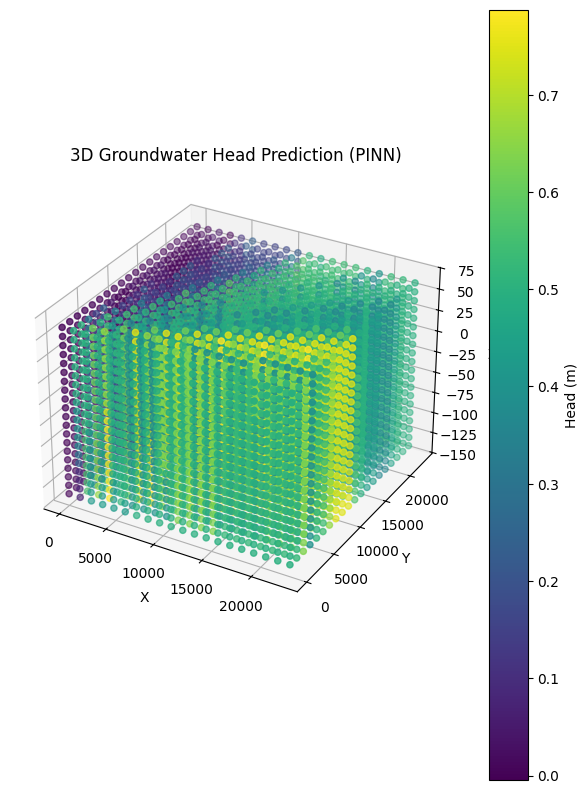

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4110: Loss = 4.2643e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4120: Loss = 4.2574e-05
Epoch 4130: Loss = 4.2578e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4140: Loss = 4.2406e-05
Epoch 4150: Loss = 4.2110e-05
Epoch 4160: Loss = 4.7968e-05
Epoch 4170: Loss = 6.2711e-05
Epoch 4180: Loss = 9.2788e-05
Epoch 4190: Loss = 6.2884e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4200.pkl
Epoch 4200: Loss = 7.4619e-05
Epoch 4200: Loss = 7.4619e-05


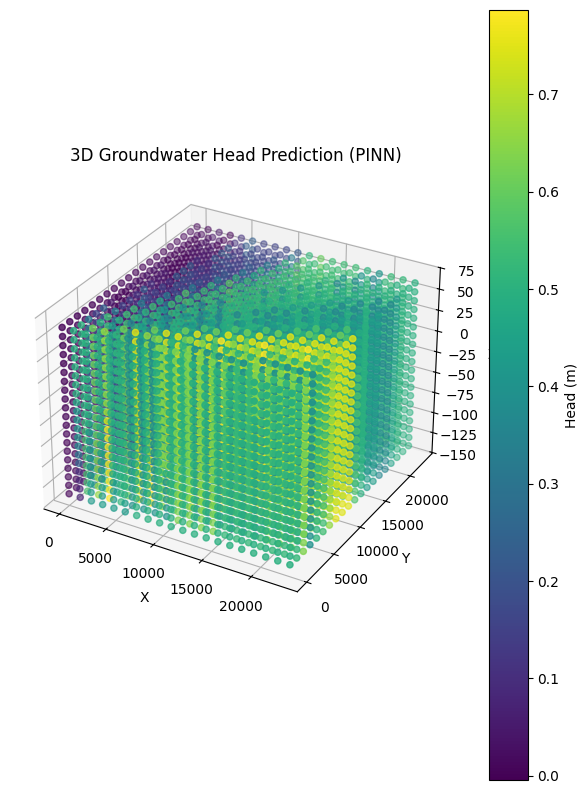

Epoch 4210: Loss = 6.7384e-05
Epoch 4220: Loss = 5.2451e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4230: Loss = 5.3141e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4240: Loss = 4.1289e-05
Epoch 4250: Loss = 4.4775e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4260: Loss = 4.5894e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4270: Loss = 4.1886e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4280: Loss = 4.1468e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4290: Loss = 4.0

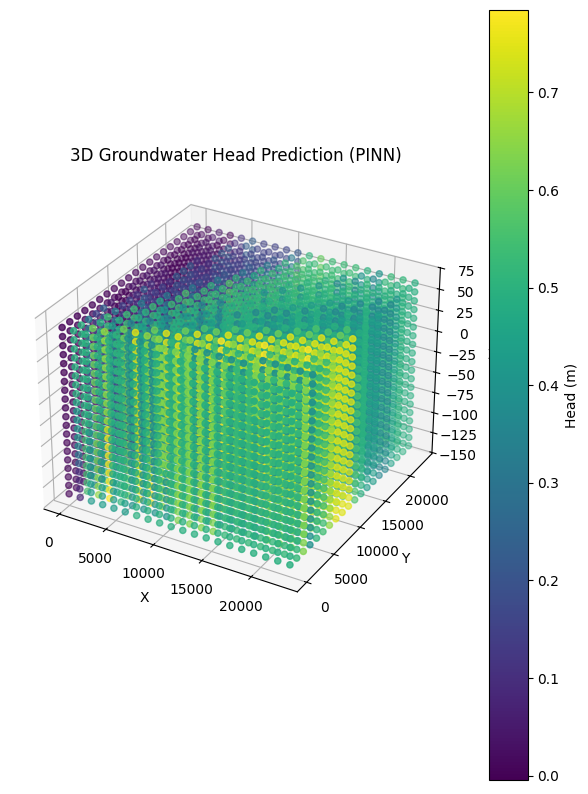

Epoch 4310: Loss = 5.2623e-05
Epoch 4320: Loss = 7.4545e-05
Epoch 4330: Loss = 7.1353e-05
Epoch 4340: Loss = 7.2482e-05
Epoch 4350: Loss = 7.8152e-05
Epoch 4360: Loss = 7.9631e-05
Epoch 4370: Loss = 7.6824e-05
Epoch 4380: Loss = 7.6416e-05
Epoch 4390: Loss = 3.8340e-04
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4400.pkl
Epoch 4400: Loss = 1.8287e-03
Epoch 4400: Loss = 1.8287e-03


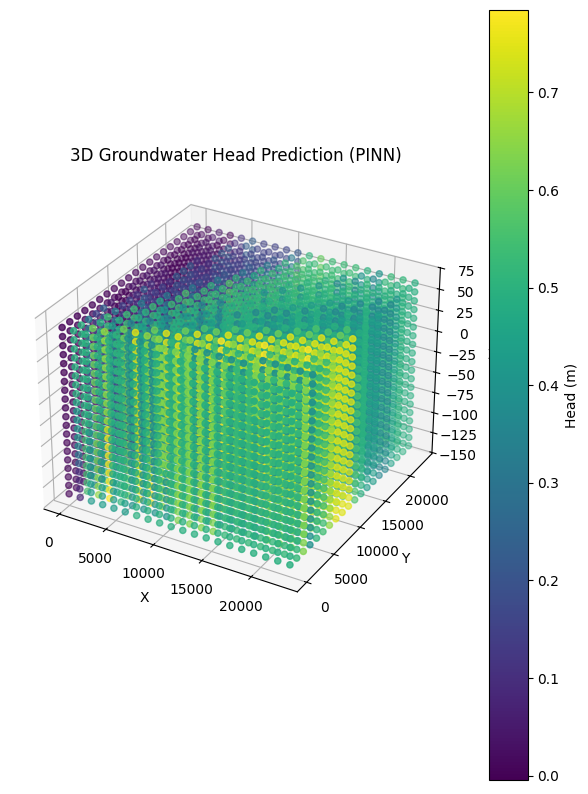

Epoch 4410: Loss = 1.9748e-03
Epoch 4420: Loss = 3.1840e-03
Epoch 4430: Loss = 7.1365e-04
Epoch 4440: Loss = 4.6232e-04
Epoch 4450: Loss = 1.4887e-04
Epoch 4460: Loss = 1.8137e-04
Epoch 4470: Loss = 9.3008e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4480: Loss = 1.6633e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4490: Loss = 3.8904e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4500.pkl
Epoch 4500: Loss = 5.6293e-05
Epoch 4500: Loss = 5.6293e-05


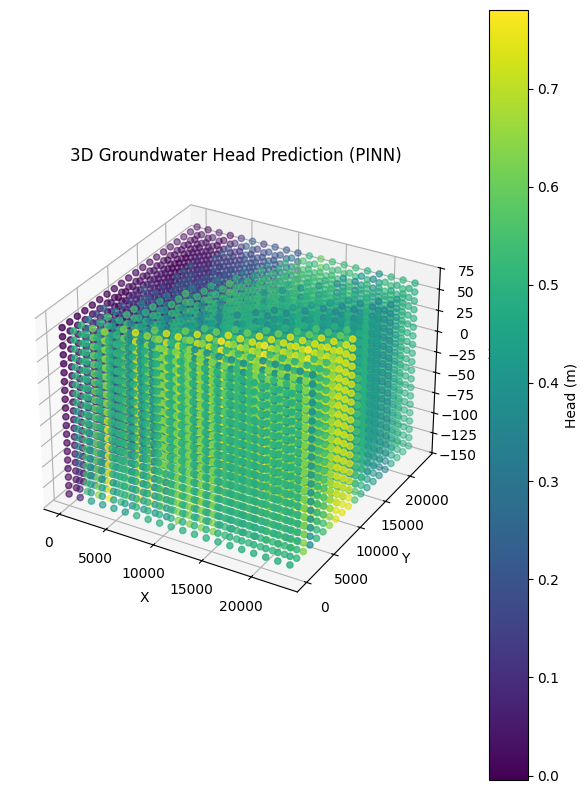

Epoch 4510: Loss = 6.6120e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4520: Loss = 3.8312e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4530: Loss = 4.0539e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4540: Loss = 3.8257e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4550: Loss = 3.7929e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4560: Loss = 4.0220e-05
Epoch 4570: Loss = 3.8922e-05
Epoch 4580: Loss = 1.4500e-04
Epoch 4590: Loss = 2.5192e-02
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4600.pkl


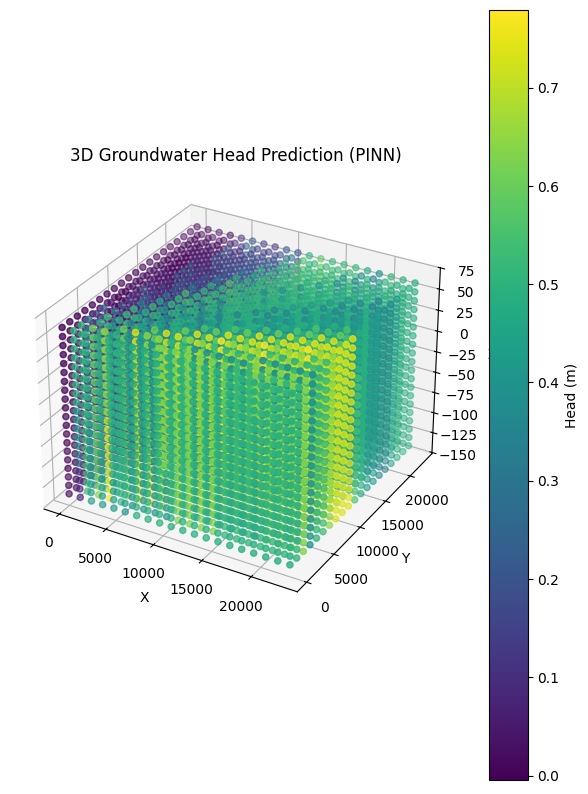

Epoch 4610: Loss = 2.4161e-04
Epoch 4620: Loss = 8.8637e-05
Epoch 4630: Loss = 1.5323e-04
Epoch 4640: Loss = 4.4443e-05
Epoch 4650: Loss = 1.5368e-04
Epoch 4660: Loss = 1.1624e-04
Epoch 4670: Loss = 5.3940e-05
Epoch 4680: Loss = 6.6435e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4690: Loss = 3.6946e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_4700.pkl
Epoch 4700: Loss = 3.6739e-05
Epoch 4700: Loss = 3.6739e-05


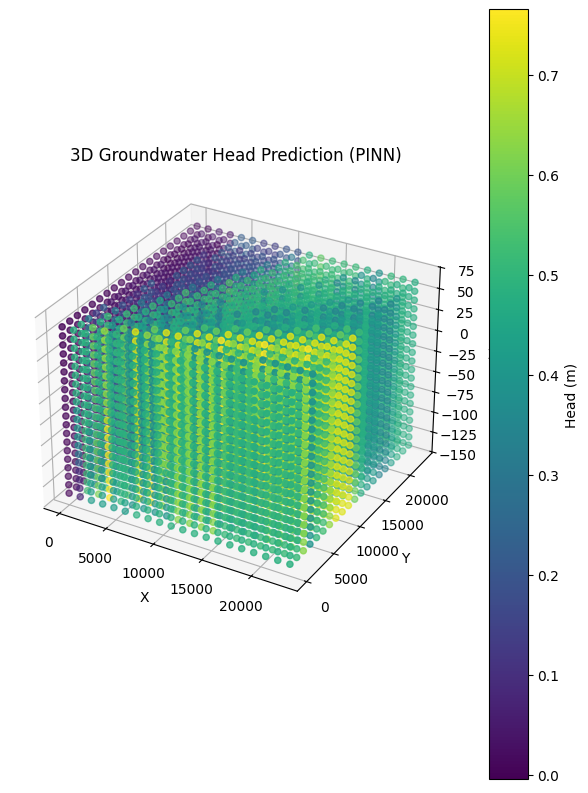

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4710: Loss = 3.6349e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4720: Loss = 3.6616e-05
Epoch 4730: Loss = 3.6374e-05
Epoch 4740: Loss = 3.6363e-05
Epoch 4750: Loss = 5.0184e-05
Epoch 4760: Loss = 3.7379e-05
Epoch 4770: Loss = 3.6583e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4780: Loss = 3.8688e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4790: Loss = 3.7

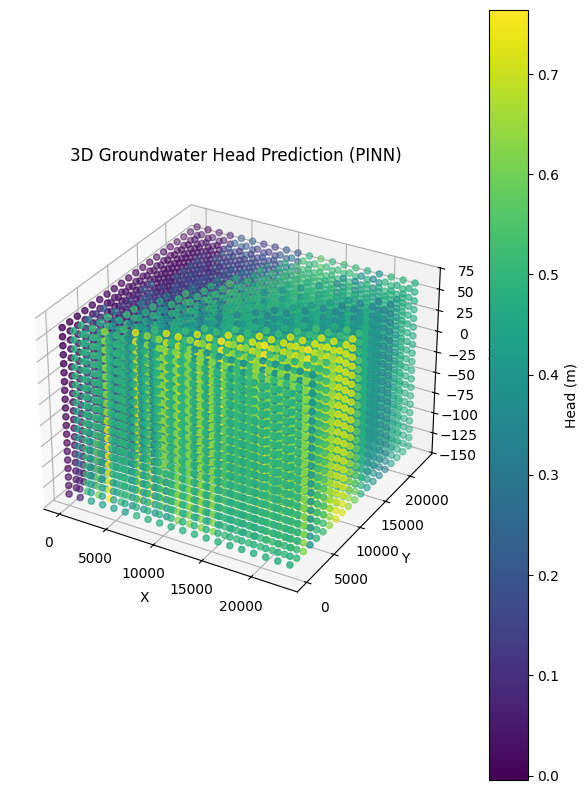

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4810: Loss = 3.5947e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4820: Loss = 3.5551e-05
Epoch 4830: Loss = 3.5624e-05
Epoch 4840: Loss = 3.6082e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4850: Loss = 3.4867e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4860: Loss = 3.4888e-05
Epoch 4870: Loss = 4.1557e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4880: Loss = 3.5686e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4890: Loss = 3.6592e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

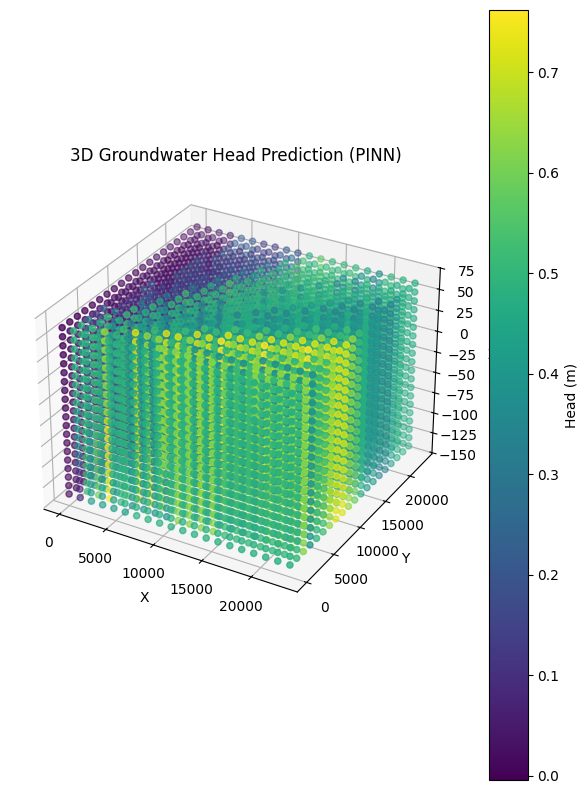

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4910: Loss = 3.7011e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4920: Loss = 4.2231e-05
Epoch 4930: Loss = 3.9888e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4940: Loss = 4.9420e-05
Epoch 4950: Loss = 2.2602e-04
Epoch 4960: Loss = 2.2661e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4970: Loss = 3.3874e-05
Epoch 4980: Loss = 3.7038e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 4990: Loss = 5.1875e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5000.pkl
Epoch 5000: Loss = 2.1500e-04
Epoch 5000: Loss = 2.1500e-04


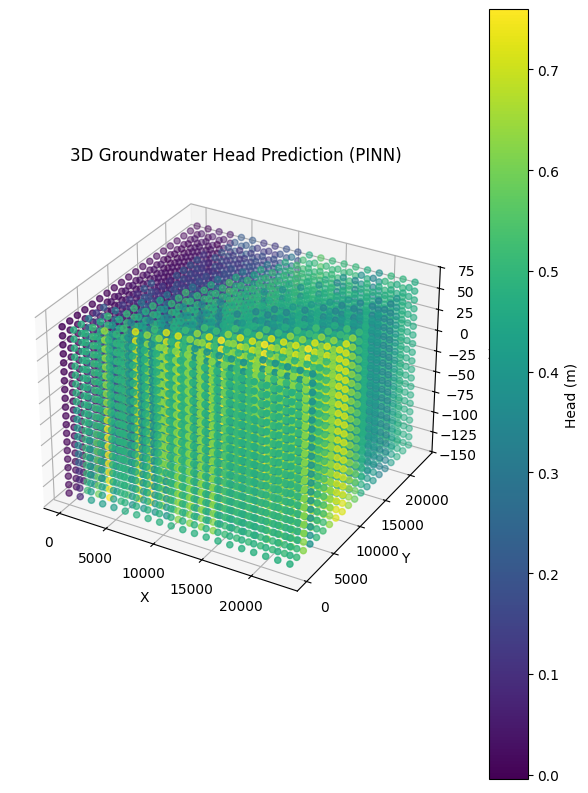

Epoch 5010: Loss = 1.8242e-04
Epoch 5020: Loss = 3.6767e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5030: Loss = 3.3795e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5040: Loss = 3.3122e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5050: Loss = 3.5958e-05
Epoch 5060: Loss = 5.2088e-05
Epoch 5070: Loss = 3.4316e-04
Epoch 5080: Loss = 1.6811e-02
Epoch 5090: Loss = 2.0555e-03
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5100.pkl
Epoch 5100: Loss = 4.8049e-03
Epoch 5100: Loss = 4.8049e-03


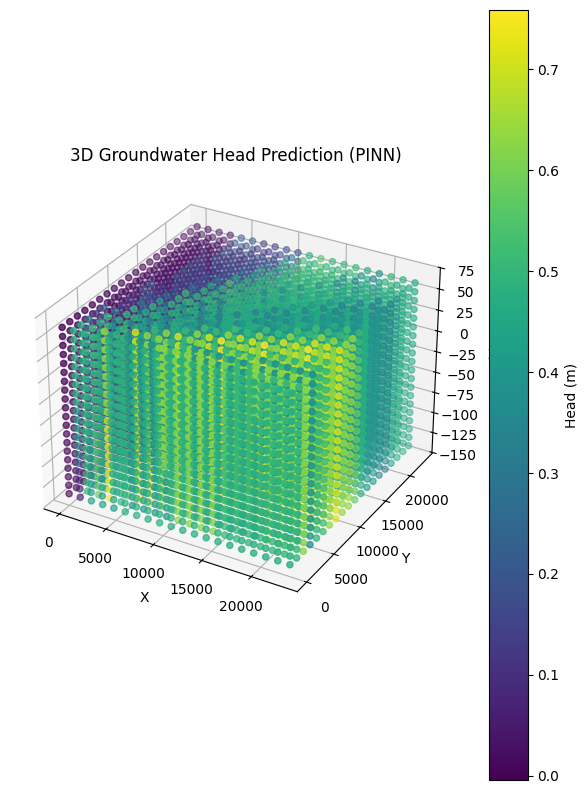

Epoch 5110: Loss = 4.9890e-04
Epoch 5120: Loss = 4.9180e-05
Epoch 5130: Loss = 1.5386e-04
Epoch 5140: Loss = 6.3121e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5150: Loss = 8.0686e-05
Epoch 5160: Loss = 7.2583e-05
Epoch 5170: Loss = 7.9310e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5180: Loss = 3.6158e-05
Epoch 5190: Loss = 3.9100e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5200.pkl
Epoch 5200: Loss = 3.1585e-05
Epoch 5200: Loss = 3.1585e-05


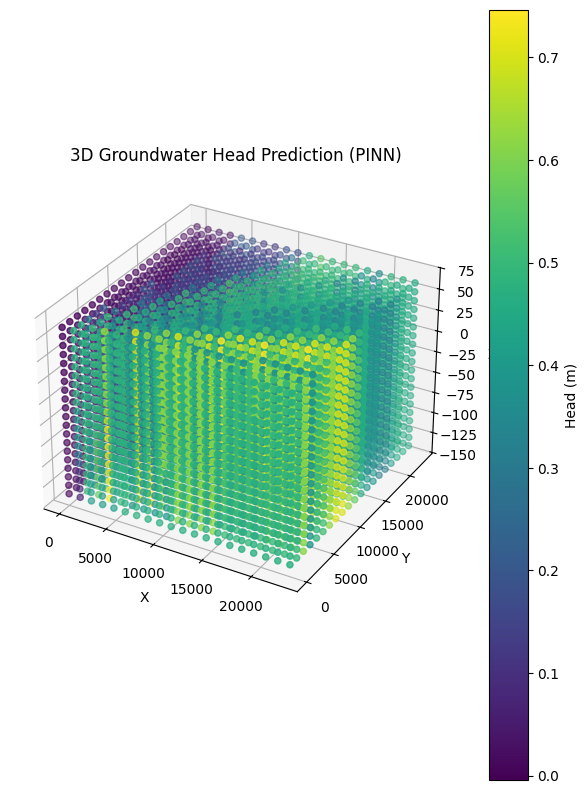

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5210: Loss = 4.9944e-05
Epoch 5220: Loss = 3.3716e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5230: Loss = 1.1263e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5240: Loss = 1.1644e-04
Epoch 5250: Loss = 1.4982e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5260: Loss = 1.1702e-04
Epoch 5270: Loss = 5.2915e-05
Epoch 5280: Loss = 3.4429e-05
Epoch 5290: Loss = 9.4826e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5300.pkl
Epoch 5300: Loss = 7.4895e-05
Epoch 5300: Loss = 7.4895e-05


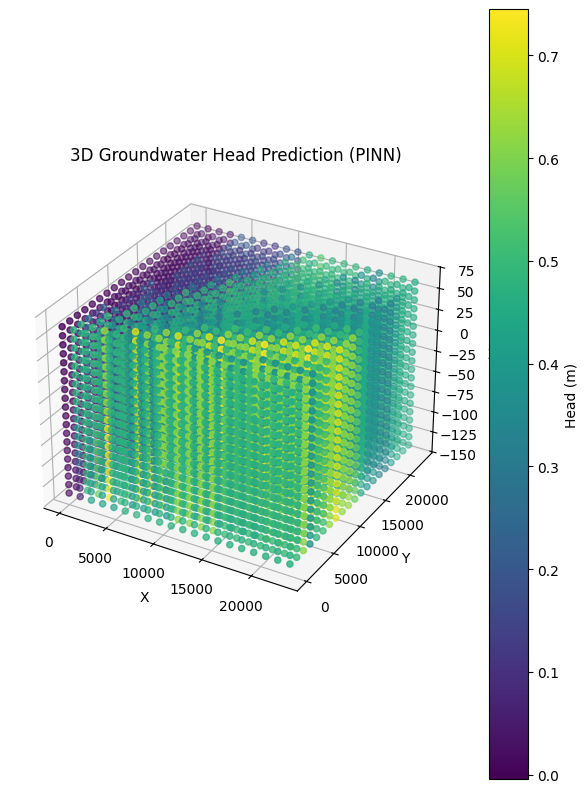

Epoch 5310: Loss = 5.3535e-05
Epoch 5320: Loss = 5.2835e-05
Epoch 5330: Loss = 4.5235e-05
Epoch 5340: Loss = 8.7349e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5350: Loss = 5.5411e-05
Epoch 5360: Loss = 4.6939e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5370: Loss = 3.3594e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5380: Loss = 3.0665e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5390: Loss = 3.4651e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5400.pkl


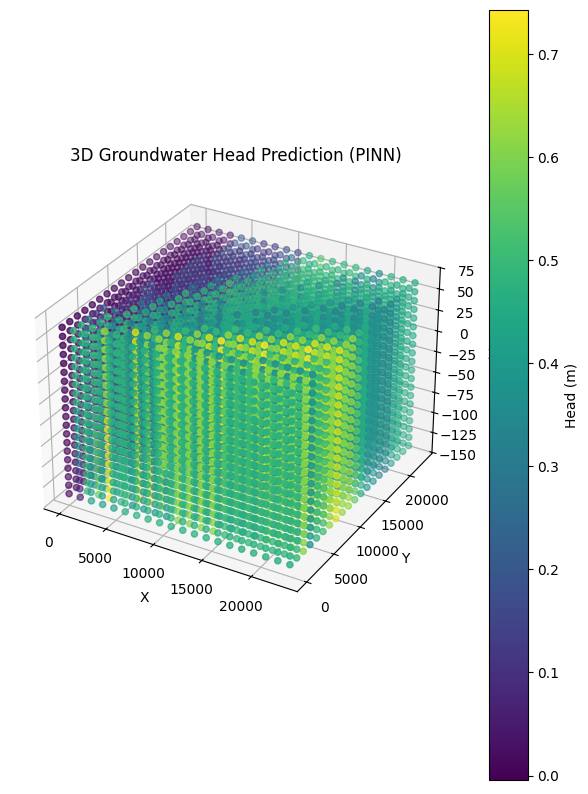

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5410: Loss = 2.9923e-05
Epoch 5420: Loss = 4.2495e-04
Epoch 5430: Loss = 2.7233e-04
Epoch 5440: Loss = 1.9891e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5450: Loss = 7.2908e-05
Epoch 5460: Loss = 1.3401e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5470: Loss = 3.1151e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5480: Loss = 6.5040e-05
Epoch 5490: Loss = 6.0113e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5500.pkl
Epoch 5500: Loss = 8.6476e-05
Epoch 5500: Loss = 8.6476e-05


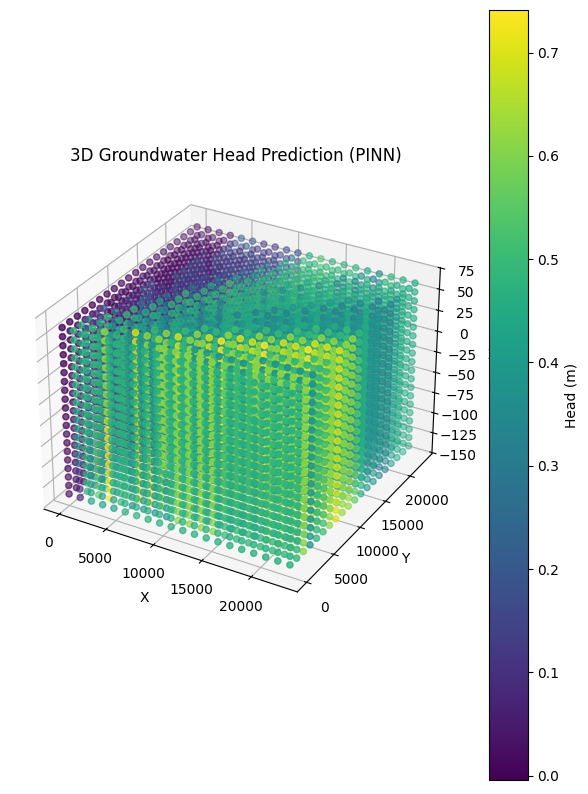

Epoch 5510: Loss = 7.4849e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5520: Loss = 5.5291e-05
Epoch 5530: Loss = 5.8345e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5540: Loss = 2.9515e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5550: Loss = 3.1885e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5560: Loss = 3.6635e-05
Epoch 5570: Loss = 4.4594e-05
Epoch 5580: Loss = 4.4846e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5590: Loss = 4.5811e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5600.pkl
Epoch 5600: Loss = 3.3034e-05
Epoch 5600: Loss = 3.3034e-05


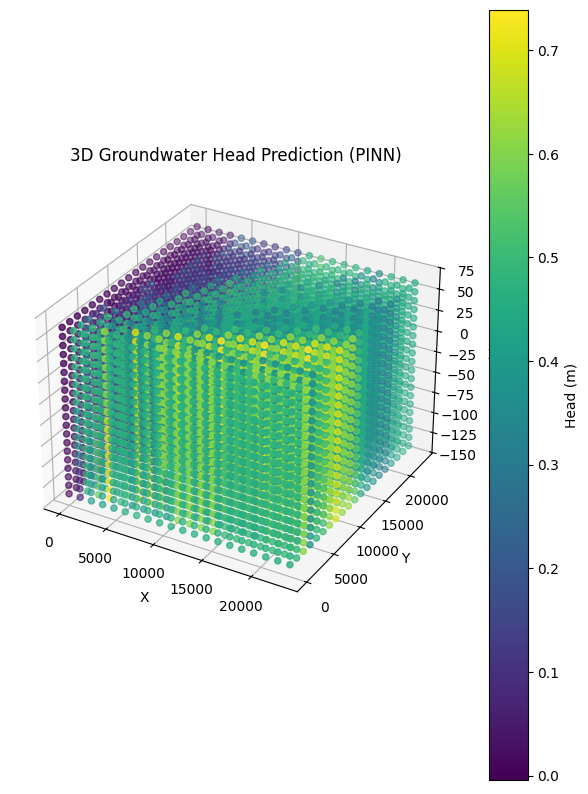

Epoch 5610: Loss = 3.3673e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5620: Loss = 3.1972e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5630: Loss = 3.1488e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5640: Loss = 2.8459e-05
Epoch 5650: Loss = 3.2880e-05
Epoch 5660: Loss = 6.3177e-05
Epoch 5670: Loss = 7.7618e-05
Epoch 5680: Loss = 6.1097e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5690: Loss = 2.8167e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5700.pkl
Epoch 5700: Loss = 1.7330e-04
Epoch 5700: Loss = 1.7330e-04


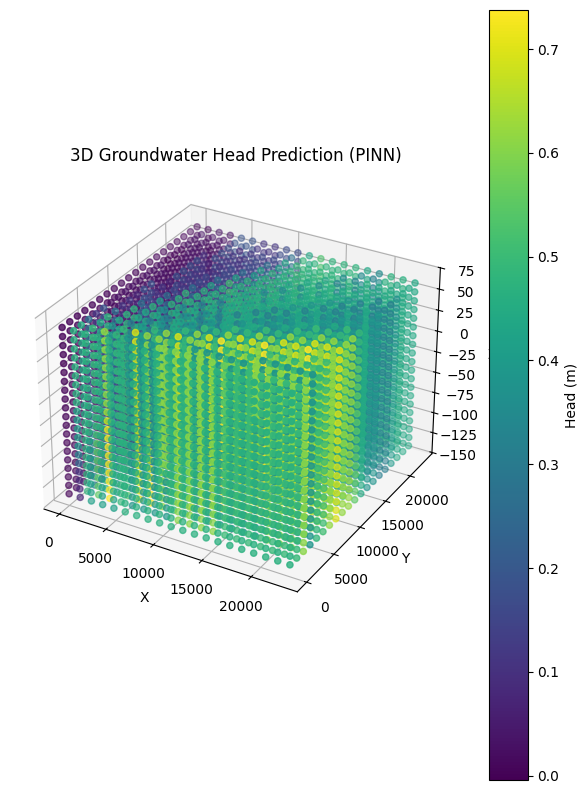

Epoch 5710: Loss = 1.3900e-02
Epoch 5720: Loss = 7.5701e-03
Epoch 5730: Loss = 4.9136e-05
Epoch 5740: Loss = 3.9383e-05
Epoch 5750: Loss = 3.7075e-04
Epoch 5760: Loss = 1.9464e-04
Epoch 5770: Loss = 9.2052e-05
Epoch 5780: Loss = 2.8468e-05
Epoch 5790: Loss = 3.7135e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5800.pkl
Epoch 5800: Loss = 4.1769e-05
Epoch 5800: Loss = 4.1769e-05


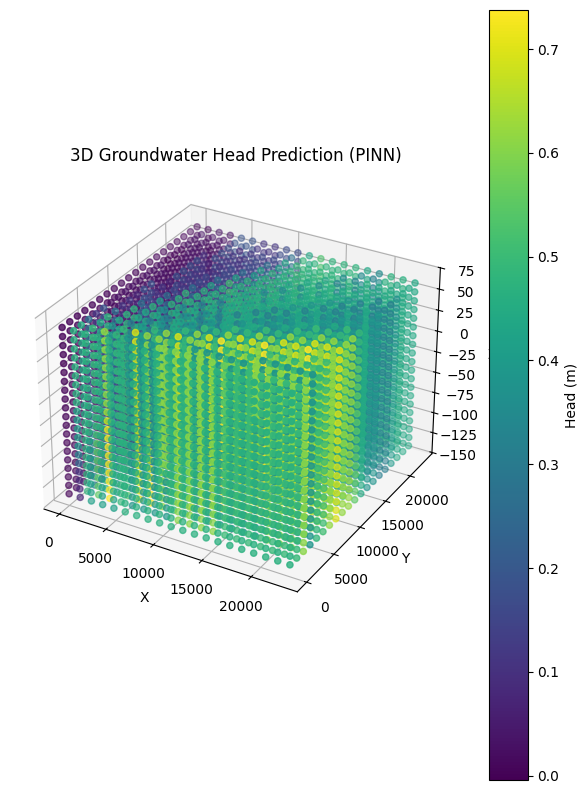

Epoch 5810: Loss = 4.4452e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5820: Loss = 2.5157e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 5830: Loss = 3.4903e-05
Epoch 5840: Loss = 3.3778e-05
Epoch 5850: Loss = 3.7425e-05
Epoch 5860: Loss = 3.1716e-05
Epoch 5870: Loss = 3.6964e-05
Epoch 5880: Loss = 3.5092e-05
Epoch 5890: Loss = 3.3161e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_5900.pkl
Epoch 5900: Loss = 3.4265e-05
Epoch 5900: Loss = 3.4265e-05


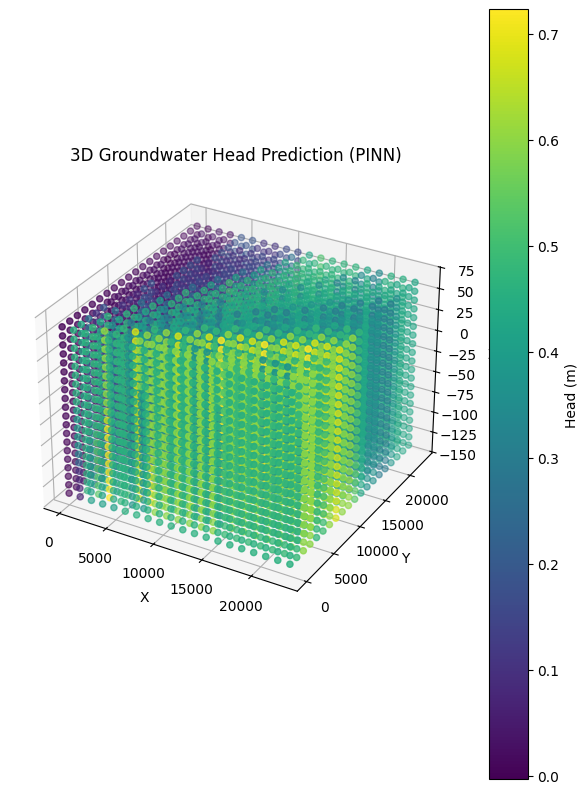

Epoch 5910: Loss = 3.3332e-05
Epoch 5920: Loss = 3.2272e-05
Epoch 5930: Loss = 3.2539e-05
Epoch 5940: Loss = 2.9978e-05
Epoch 5950: Loss = 3.0373e-05
Epoch 5960: Loss = 2.9051e-05
Epoch 5970: Loss = 4.6867e-05
Epoch 5980: Loss = 2.8713e-05
Epoch 5990: Loss = 2.8949e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6000.pkl
Epoch 6000: Loss = 2.8609e-05
Epoch 6000: Loss = 2.8609e-05


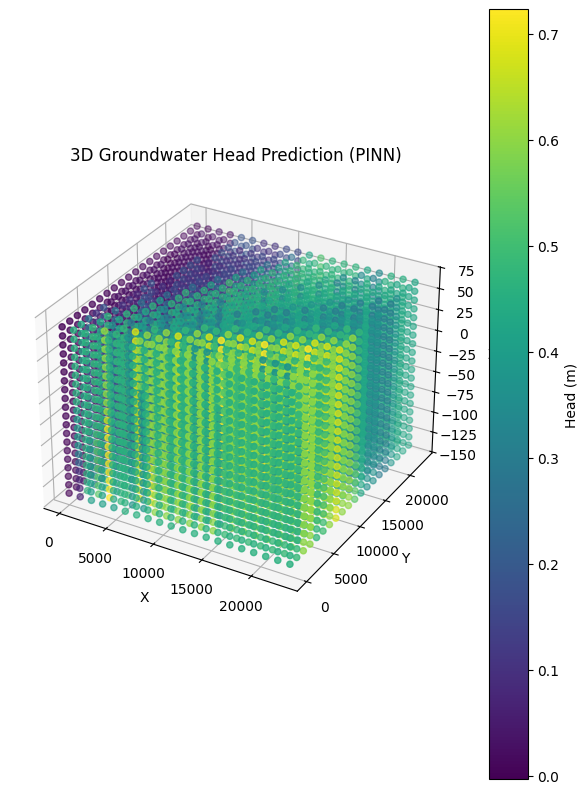

Epoch 6010: Loss = 2.8040e-05
Epoch 6020: Loss = 5.1107e-05
Epoch 6030: Loss = 9.5792e-05
Epoch 6040: Loss = 8.3363e-05
Epoch 6050: Loss = 1.2808e-04
Epoch 6060: Loss = 5.1392e-05
Epoch 6070: Loss = 5.1041e-05
Epoch 6080: Loss = 2.6888e-05
Epoch 6090: Loss = 3.8401e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6100.pkl
Epoch 6100: Loss = 3.3667e-05
Epoch 6100: Loss = 3.3667e-05


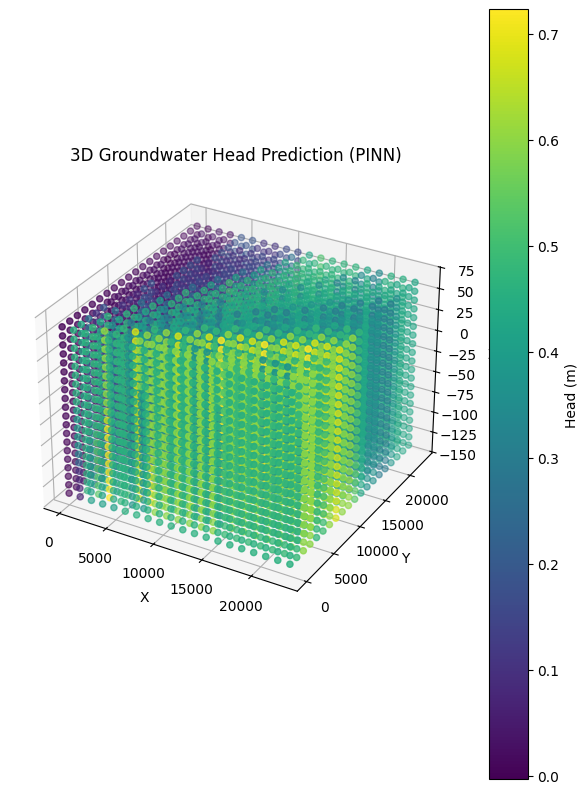

Epoch 6110: Loss = 2.8069e-05
Epoch 6120: Loss = 2.6847e-05
Epoch 6130: Loss = 2.9032e-05
Epoch 6140: Loss = 3.8115e-05
Epoch 6150: Loss = 2.6412e-05
Epoch 6160: Loss = 2.7214e-05
Epoch 6170: Loss = 2.6709e-05
Epoch 6180: Loss = 2.6416e-05
Epoch 6190: Loss = 2.6558e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6200.pkl
Epoch 6200: Loss = 2.6350e-05
Epoch 6200: Loss = 2.6350e-05


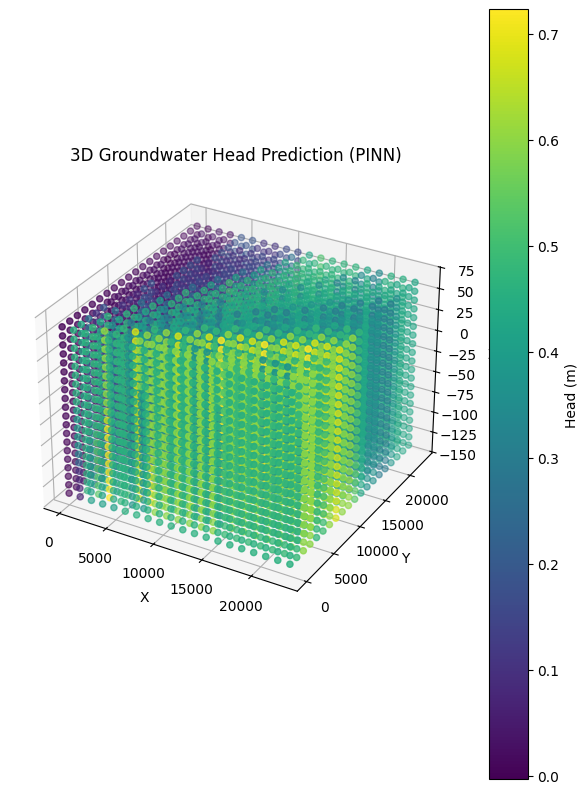

Epoch 6210: Loss = 2.9074e-05
Epoch 6220: Loss = 2.6258e-05
Epoch 6230: Loss = 2.8308e-05
Epoch 6240: Loss = 2.8230e-05
Epoch 6250: Loss = 3.0251e-05
Epoch 6260: Loss = 3.0059e-05
Epoch 6270: Loss = 3.8451e-05
Epoch 6280: Loss = 8.9706e-05
Epoch 6290: Loss = 8.8666e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6300.pkl
Epoch 6300: Loss = 7.5662e-05
Epoch 6300: Loss = 7.5662e-05


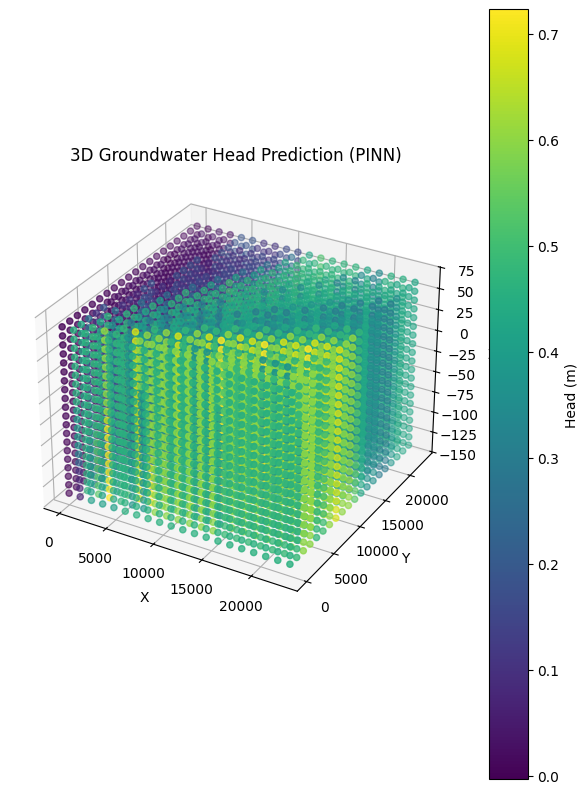

Epoch 6310: Loss = 1.5252e-04
Epoch 6320: Loss = 1.4836e-04
Epoch 6330: Loss = 6.2044e-05
Epoch 6340: Loss = 7.2280e-05
Epoch 6350: Loss = 6.7653e-05
Epoch 6360: Loss = 6.0184e-05
Epoch 6370: Loss = 3.1239e-05
Epoch 6380: Loss = 5.2560e-05
Epoch 6390: Loss = 2.6531e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6400.pkl
Epoch 6400: Loss = 2.5795e-05
Epoch 6400: Loss = 2.5795e-05


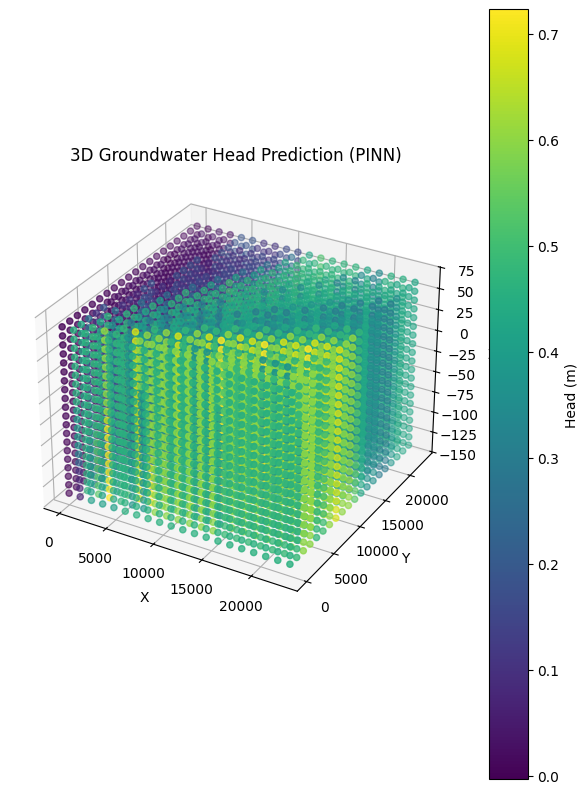

Epoch 6410: Loss = 2.8400e-05
Epoch 6420: Loss = 2.4982e-05
Epoch 6430: Loss = 2.4850e-05
Epoch 6440: Loss = 2.4391e-05
Epoch 6450: Loss = 2.6617e-05
Epoch 6460: Loss = 8.8233e-05
Epoch 6470: Loss = 3.7791e-05
Epoch 6480: Loss = 5.9282e-05
Epoch 6490: Loss = 6.8189e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6500.pkl
Epoch 6500: Loss = 6.4252e-05
Epoch 6500: Loss = 6.4252e-05


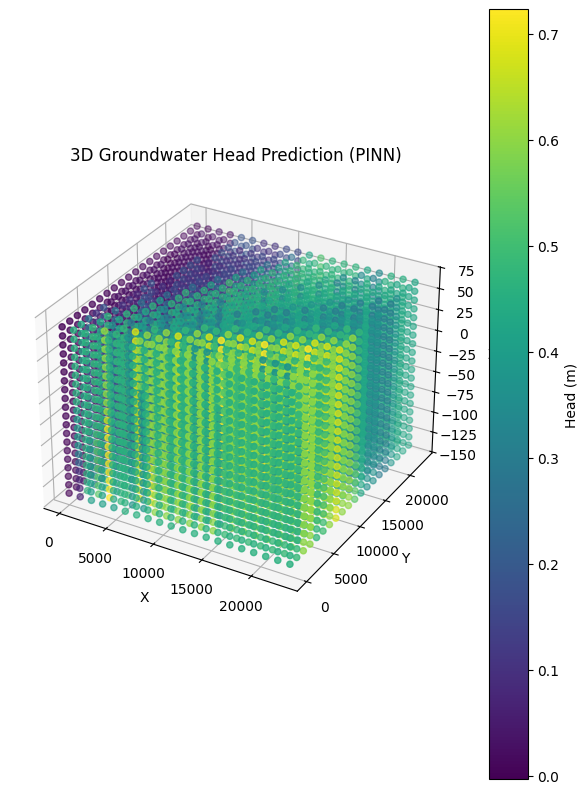

Epoch 6510: Loss = 6.9646e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6520: Loss = 2.8289e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6530: Loss = 2.5149e-05
Epoch 6540: Loss = 2.3756e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6550: Loss = 3.3395e-05
Epoch 6560: Loss = 2.8361e-05
Epoch 6570: Loss = 2.9646e-05
Epoch 6580: Loss = 2.3980e-05
Epoch 6590: Loss = 2.5479e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6600.pkl
Epoch 6600: Loss = 2.4977e-05
Epoch 6600: Loss = 2.4977e-05


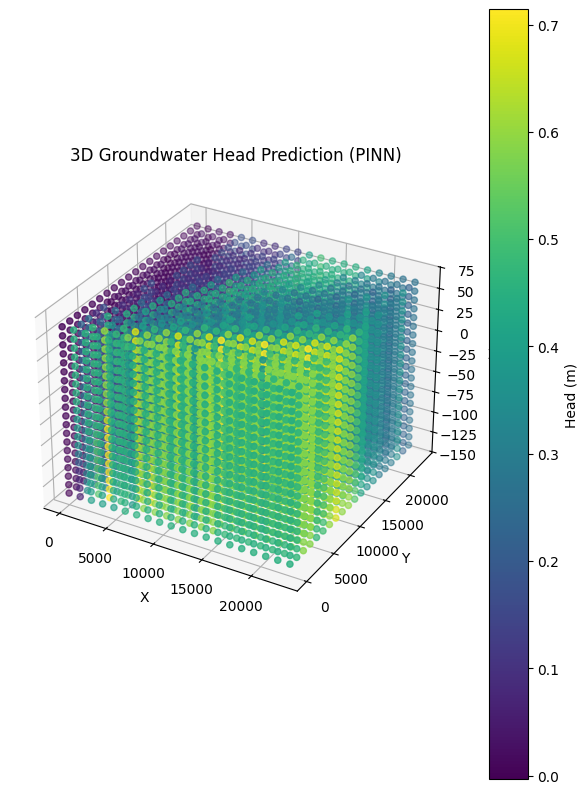

Epoch 6610: Loss = 2.8135e-05
Epoch 6620: Loss = 2.7125e-05
Epoch 6630: Loss = 3.4538e-05
Epoch 6640: Loss = 2.8561e-05
Epoch 6650: Loss = 2.6037e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6660: Loss = 2.5108e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6670: Loss = 2.3493e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6680: Loss = 2.2872e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6690: Loss = 2.3125e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6700.pkl
Epoch 6700: Loss = 2.3207e-05
Epoch 6700: Loss = 2.3207e-05


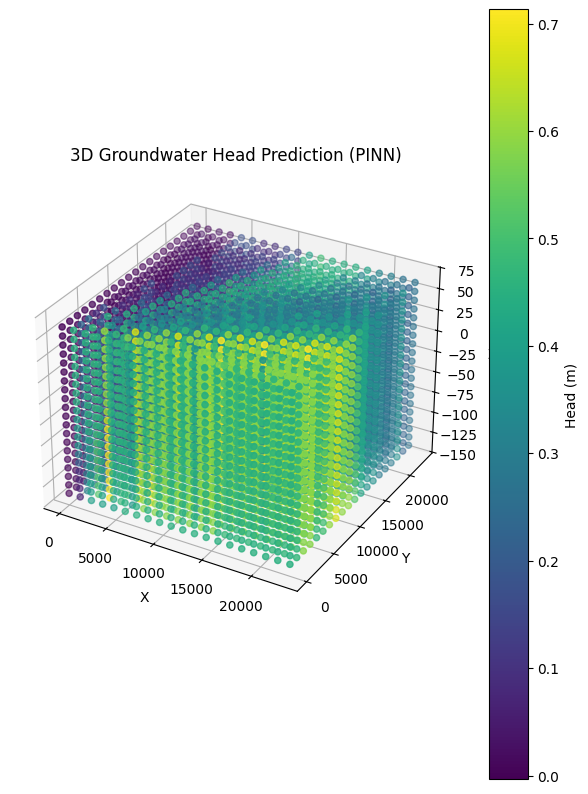

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6710: Loss = 2.2655e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6720: Loss = 2.2694e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6730: Loss = 2.2719e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6740: Loss = 2.2511e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6750: Loss = 2.2434e-05
Epoch 6760: Loss = 2.2474e-05


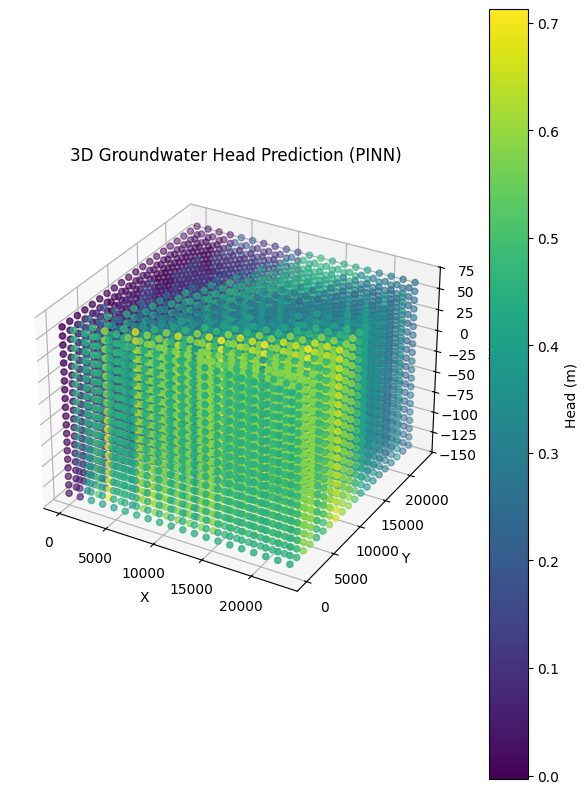

Epoch 6810: Loss = 2.6676e-05
Epoch 6820: Loss = 1.9472e-04
Epoch 6830: Loss = 3.0188e-05
Epoch 6840: Loss = 1.7983e-04
Epoch 6850: Loss = 1.4638e-04
Epoch 6860: Loss = 2.3909e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6870: Loss = 2.4383e-05
Epoch 6880: Loss = 3.8675e-05
Epoch 6890: Loss = 2.7676e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_6900.pkl
Epoch 6900: Loss = 2.6485e-05
Epoch 6900: Loss = 2.6485e-05


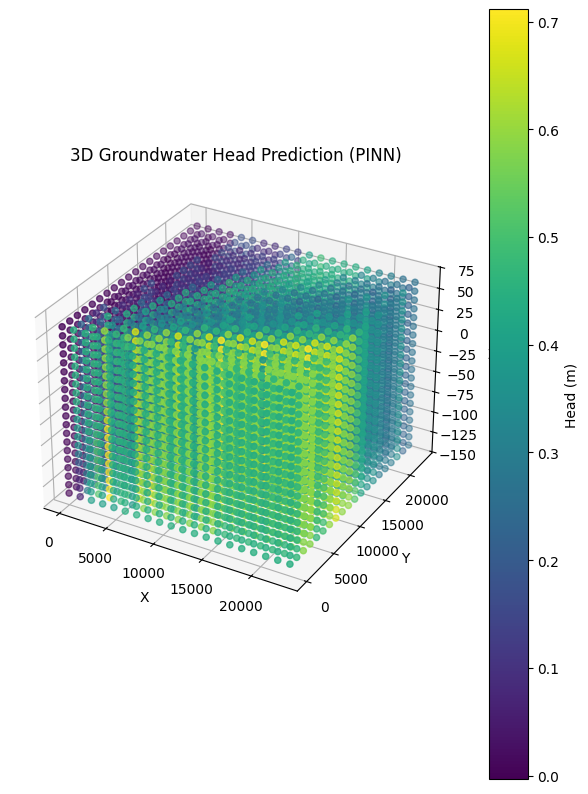

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6910: Loss = 2.2214e-05
Epoch 6920: Loss = 5.1712e-05
Epoch 6930: Loss = 6.0660e-05
Epoch 6940: Loss = 3.4241e-04
Epoch 6950: Loss = 2.1928e-04
Epoch 6960: Loss = 2.0315e-04
Epoch 6970: Loss = 1.7639e-04
Epoch 6980: Loss = 2.1848e-04
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 6990: Loss = 3.2856e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_7000.pkl
Epoch 7000: Loss = 3.9243e-05
Epoch 7000: Loss = 3.9243e-05


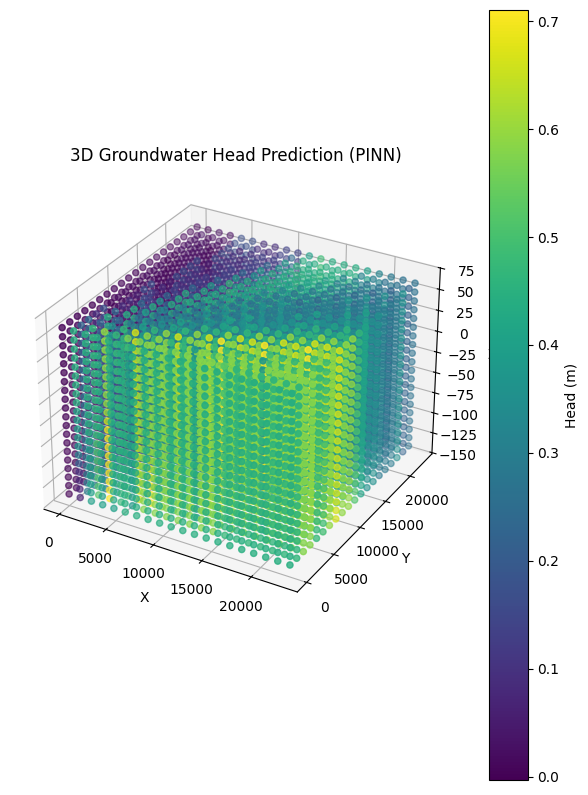

Epoch 7010: Loss = 7.4093e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7020: Loss = 5.0237e-05
Epoch 7030: Loss = 2.6350e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7040: Loss = 2.1600e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7050: Loss = 2.1694e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7060: Loss = 2.1475e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7070: Loss = 2.0890e-05
Epoch 7080: Loss = 2.1363e-05
Epoch 7090: Loss = 2.1862e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_7100.pkl


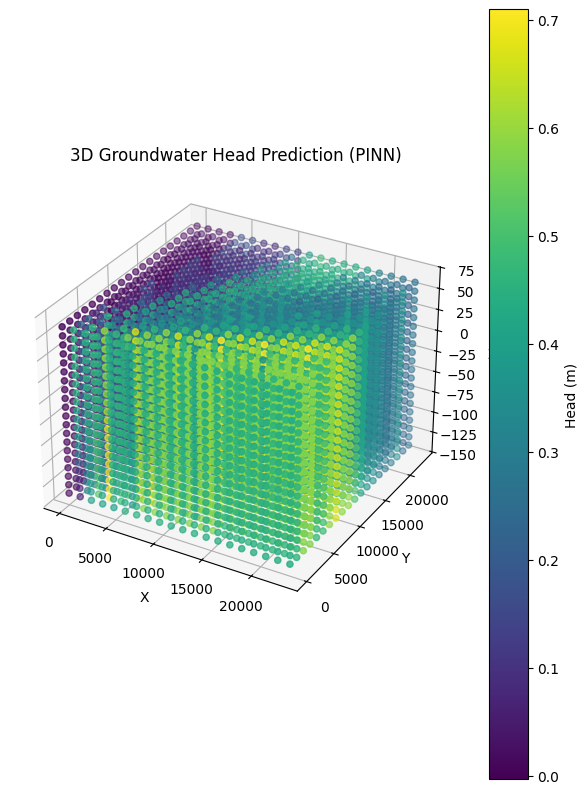

Epoch 7110: Loss = 2.1485e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7120: Loss = 2.3238e-05
Epoch 7130: Loss = 2.1490e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7140: Loss = 2.4028e-05
Epoch 7150: Loss = 2.6961e-05
Epoch 7160: Loss = 2.1634e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7170: Loss = 2.0752e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7180: Loss = 2.2201e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7190: Loss = 2.0408e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

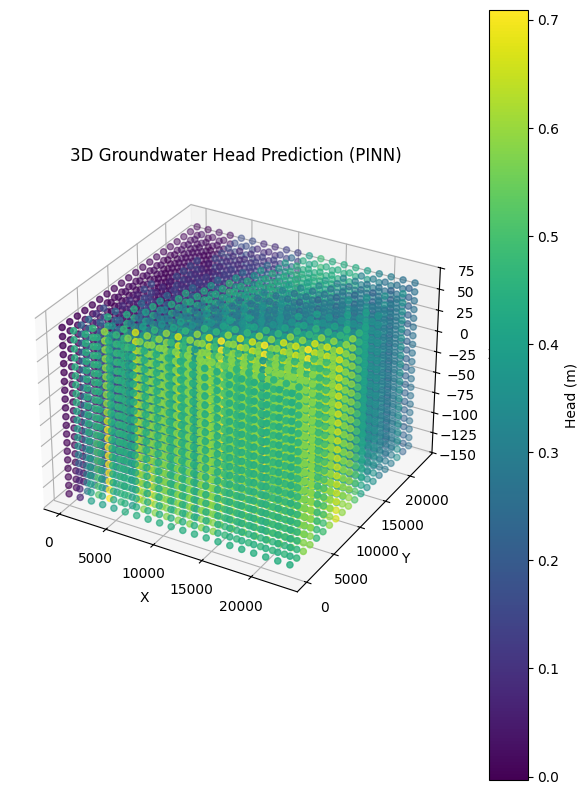

Epoch 7210: Loss = 2.3033e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7220: Loss = 2.0342e-05
Epoch 7230: Loss = 2.9292e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7240: Loss = 2.0281e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7250: Loss = 2.0939e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7260: Loss = 2.0266e-05
Epoch 7270: Loss = 2.1253e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_pa

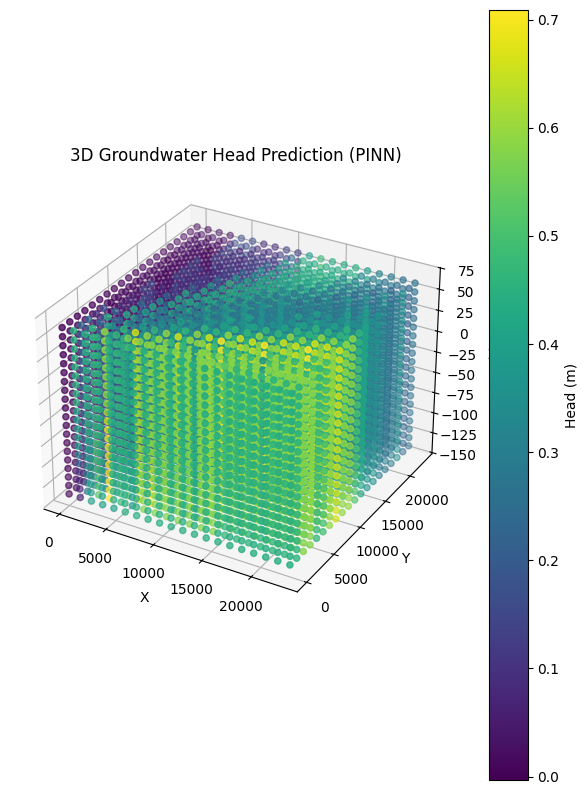

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7310: Loss = 1.9980e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7320: Loss = 1.9946e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/M

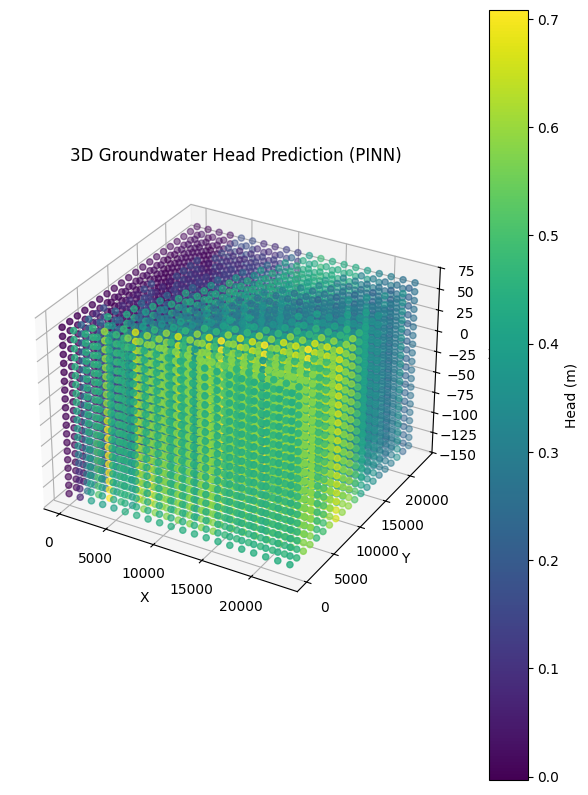

Epoch 7410: Loss = 1.9850e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7420: Loss = 1.9962e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7430: Loss = 1.9584e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7440: Loss = 1.9778e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7450: Loss = 1.9542e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content

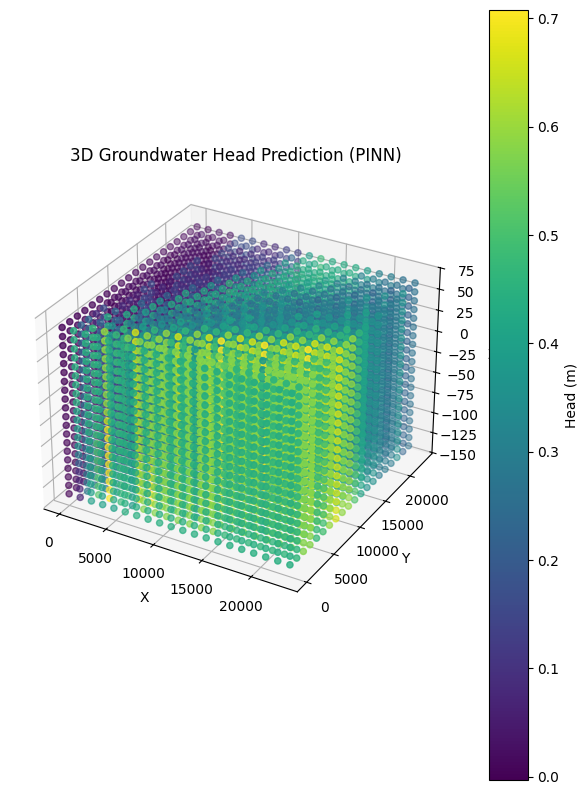

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7510: Loss = 2.0033e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7520: Loss = 1.9309e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7530: Loss = 1.9295e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7540: Loss = 2.0953e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7550: Loss = 1.9233e-05
✅ Parameters saved at /content

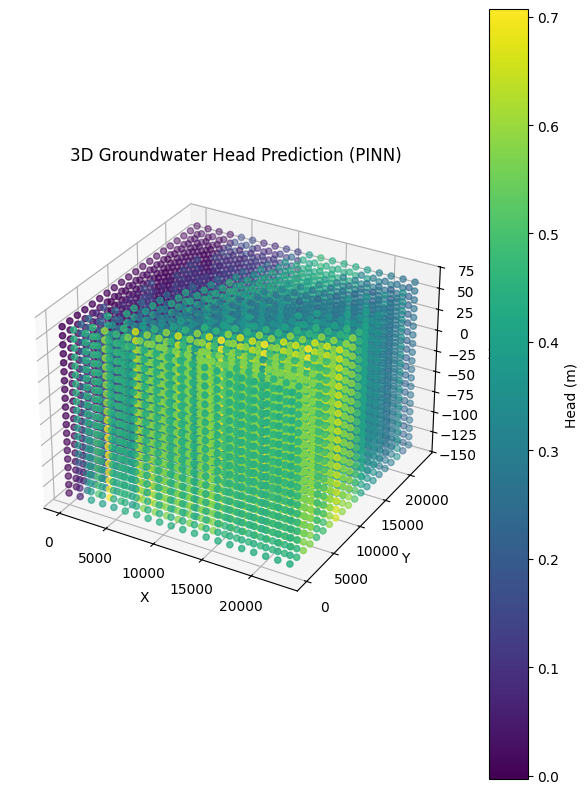

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7610: Loss = 1.9052e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7620: Loss = 1.9145e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7630: Loss = 1.8957e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7640: Loss = 1.9376e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7650: Loss = 1.9990e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7660: Loss = 1.9085e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl


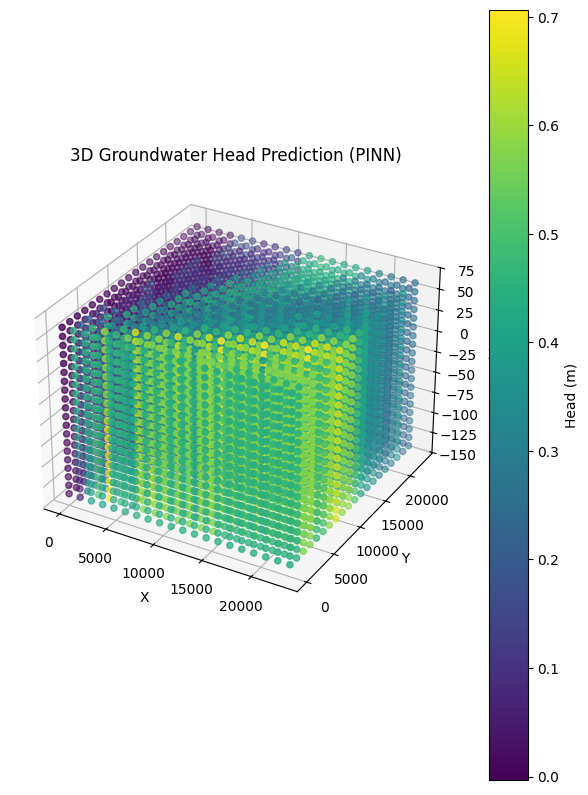

Epoch 7710: Loss = 3.0978e-05
Epoch 7720: Loss = 3.5849e-05
Epoch 7730: Loss = 2.8617e-05
Epoch 7740: Loss = 2.5920e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7750: Loss = 2.2174e-05
Epoch 7760: Loss = 2.6864e-05
Epoch 7770: Loss = 1.8718e-05
Epoch 7780: Loss = 3.0666e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7790: Loss = 2.3618e-05
✅ Parameters saved at /content/drive/MyDrive/backup_params_epoch_7800.pkl
Epoch 7800: Loss = 3.0951e-05
Epoch 7800: Loss = 3.0951e-05


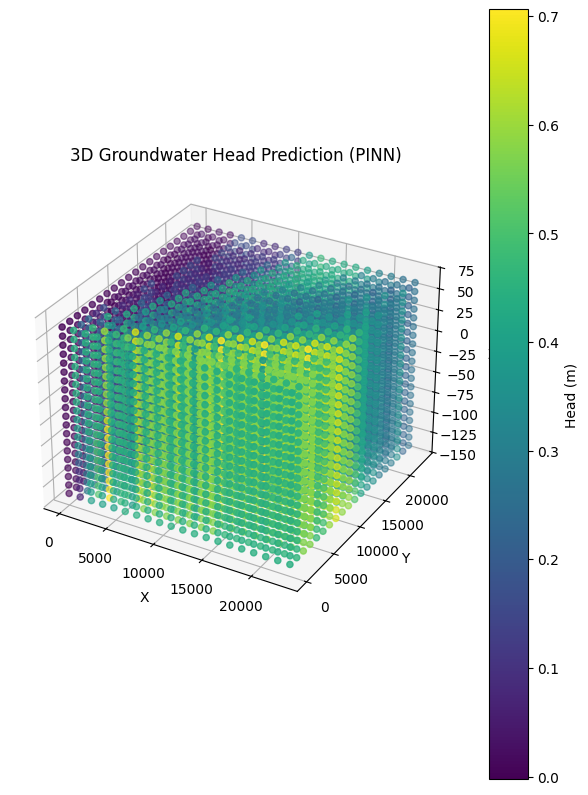

Epoch 7810: Loss = 3.2098e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7820: Loss = 1.9722e-05
Epoch 7830: Loss = 1.9918e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7840: Loss = 1.8383e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7850: Loss = 1.8552e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7860: Loss = 1.8901e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7870: Loss = 1.8342e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_pa

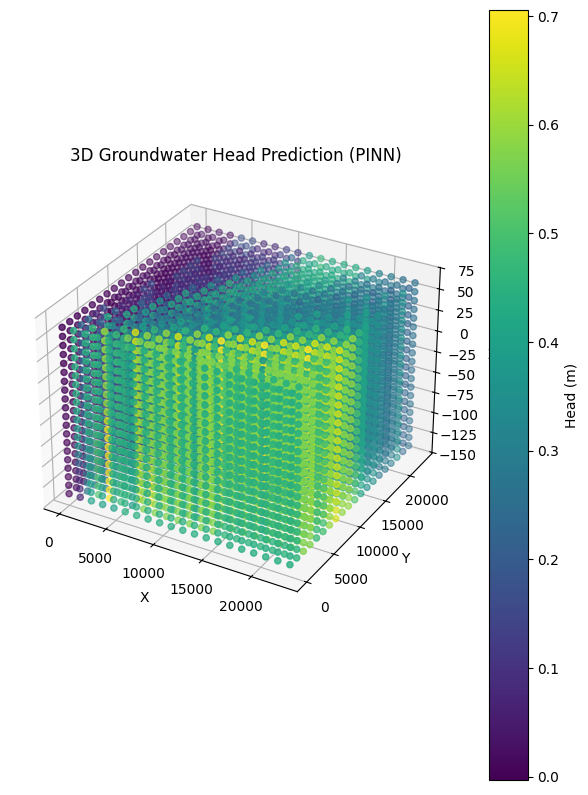

Epoch 7910: Loss = 1.8828e-05
Epoch 7920: Loss = 1.9556e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7930: Loss = 1.8404e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7940: Loss = 1.8203e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7950: Loss = 1.8168e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7960: Loss = 1.8170e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7970: Loss = 1.8407e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7980: Loss = 1.8115e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 7990: Loss = 1.8023e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

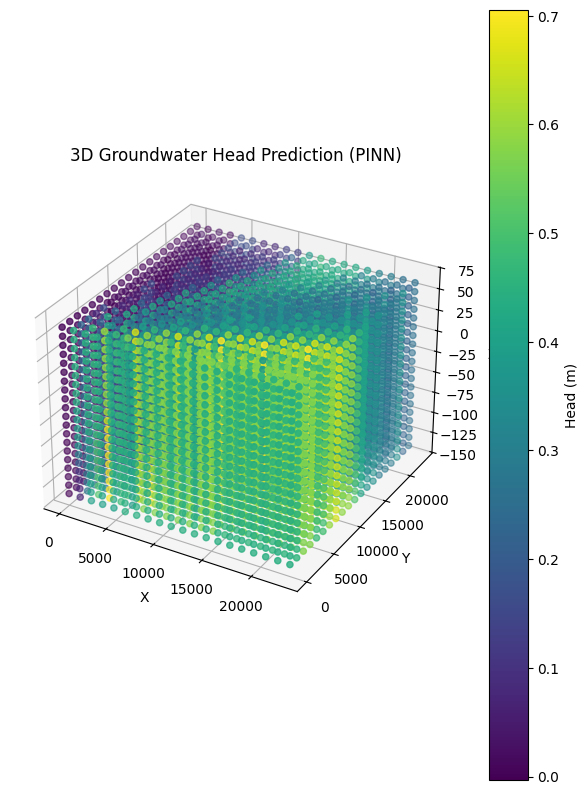

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8010: Loss = 1.8042e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8020: Loss = 1.7933e-05
Epoch 8030: Loss = 1.8047e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8040: Loss = 1.7913e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8050: Loss = 1.7876e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8060: Loss = 1.8208e-05


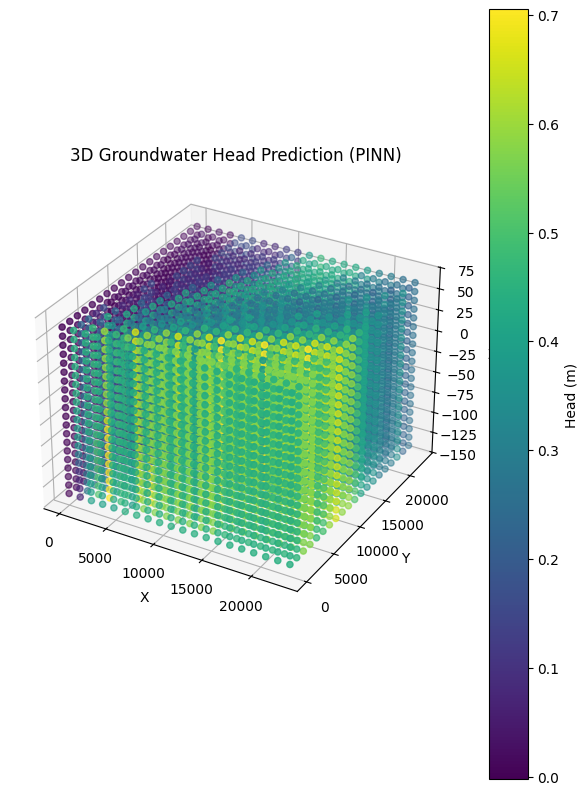

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8110: Loss = 1.7714e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8120: Loss = 1.7782e-05
Epoch 8130: Loss = 1.8040e-05
Epoch 8140: Loss = 1.7723e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8150: Loss = 1.7700e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8160: Loss = 1.8070e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl


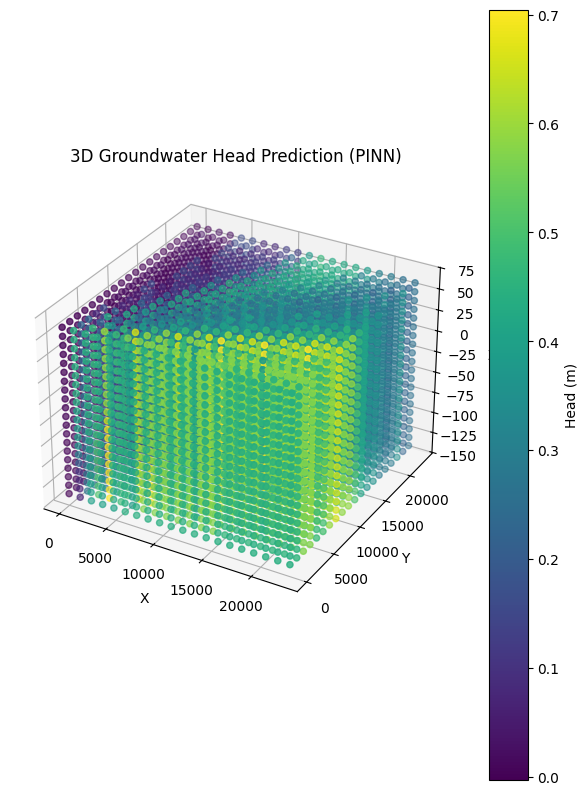

Epoch 8210: Loss = 2.1194e-05
Epoch 8220: Loss = 2.5044e-05
Epoch 8230: Loss = 2.4185e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8240: Loss = 1.7442e-05
Epoch 8250: Loss = 1.7838e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8260: Loss = 1.8032e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8270: Loss = 1.8078e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8280: Loss = 1.7686e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8290: Loss = 1.7

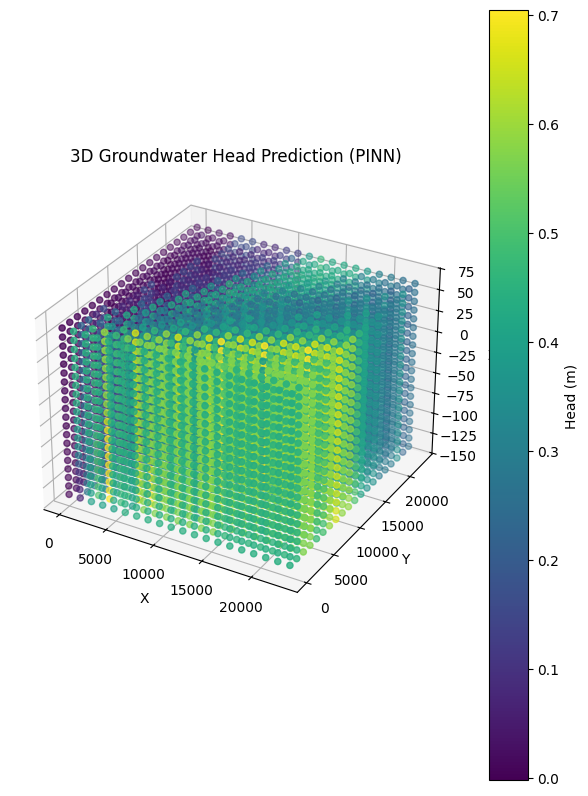

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8310: Loss = 1.7521e-05
Epoch 8320: Loss = 1.7295e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8330: Loss = 1.7237e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8340: Loss = 1.7261e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8350: Loss = 1.7634e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8360: Loss = 1.7395e-05


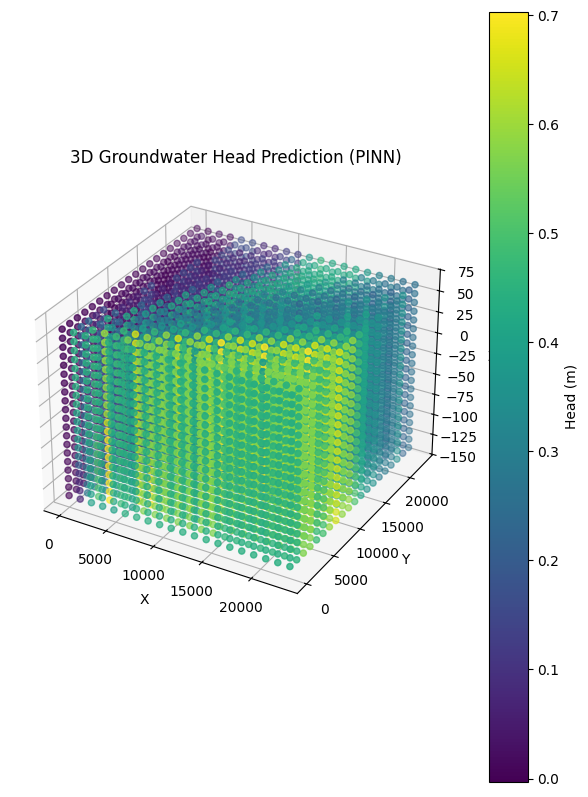

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8410: Loss = 1.7492e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8420: Loss = 1.7133e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8430: Loss = 1.7135e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8440: Loss = 1.7195e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8450: Loss = 1.6960e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content

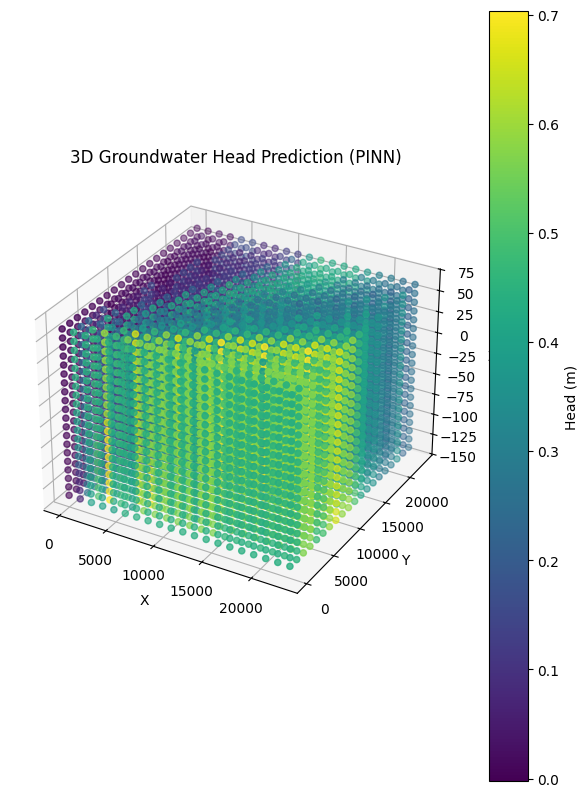

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8510: Loss = 1.7372e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8520: Loss = 1.7532e-05
Epoch 8530: Loss = 1.7519e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8540: Loss = 1.6813e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8550: Loss = 1.6738e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content

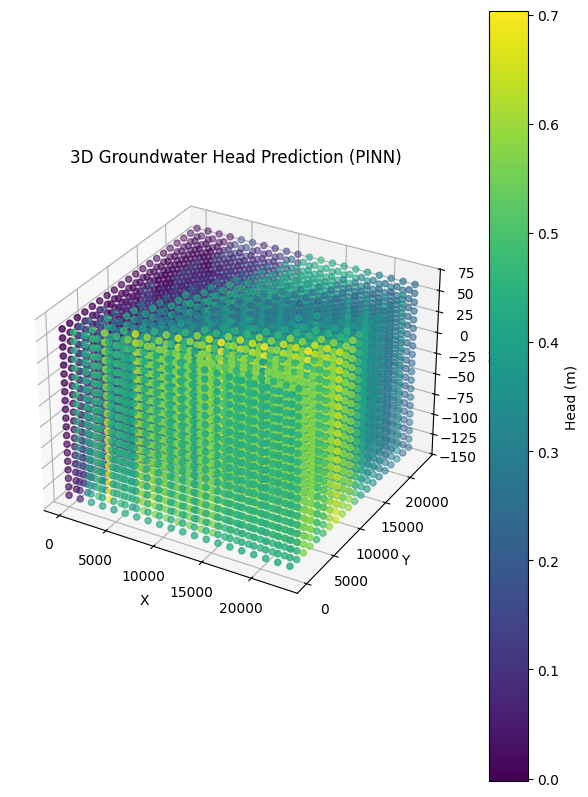

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8610: Loss = 1.6622e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8620: Loss = 1.6858e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8630: Loss = 1.6599e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8640: Loss = 1.7134e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8650: Loss = 1.6570e-05
✅ Parameters saved at /content

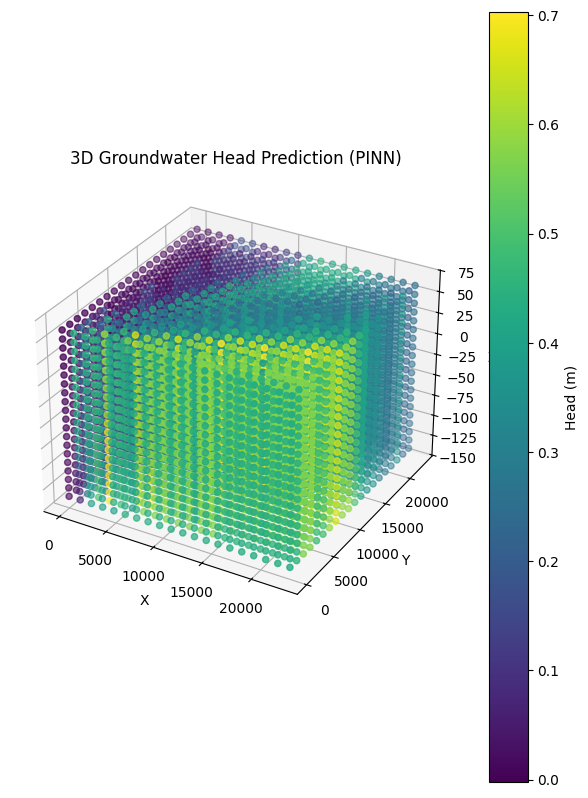

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8710: Loss = 1.6545e-05
Epoch 8720: Loss = 1.6872e-05
Epoch 8730: Loss = 1.6879e-05
Epoch 8740: Loss = 1.7070e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8750: Loss = 1.7109e-05
Epoch 8760: Loss = 1.6668e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8770: Loss = 1.8340e-05
Epoch 8780: Loss = 1.7204e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8790: Loss = 1.6290e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

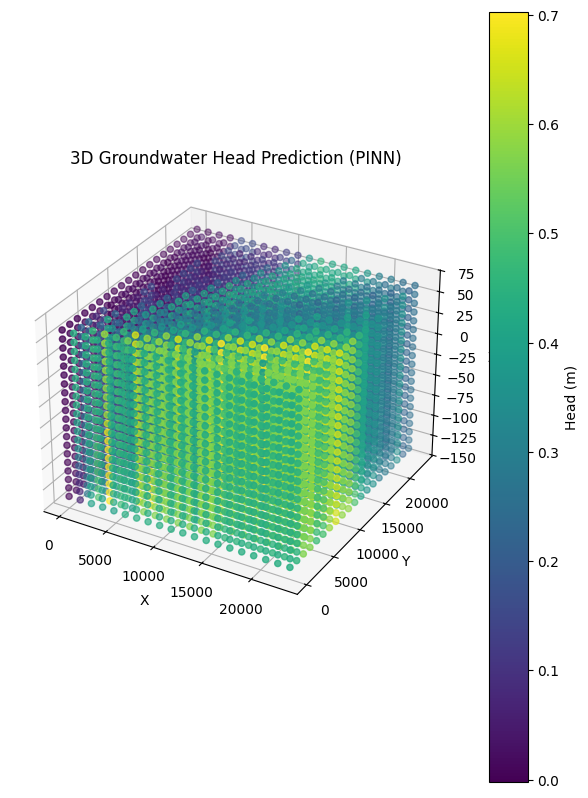

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8810: Loss = 1.6217e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8820: Loss = 1.6579e-05
Epoch 8830: Loss = 1.6187e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8840: Loss = 1.6201e-05
Epoch 8850: Loss = 1.6159e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8860: Loss = 1.6866e-05


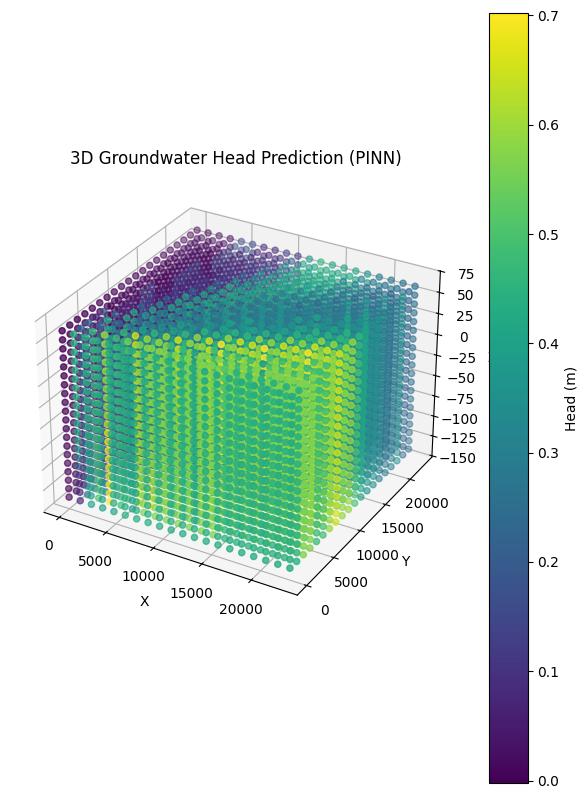

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8910: Loss = 1.6073e-05
Epoch 8920: Loss = 1.6597e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8930: Loss = 1.6620e-05
Epoch 8940: Loss = 1.6109e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8950: Loss = 1.6174e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8960: Loss = 1.5993e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8970: Loss = 1.5989e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 8980: Loss = 1.7833e-05
✅ Parameters saved at 

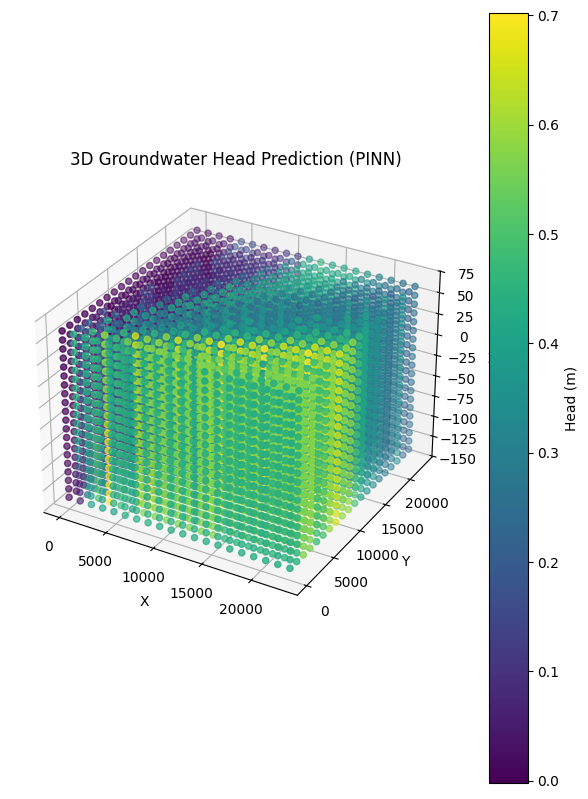

Epoch 9010: Loss = 1.6615e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9020: Loss = 1.5888e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9030: Loss = 1.5875e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9040: Loss = 1.5984e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9050: Loss = 1.7144e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9060: Loss = 1.5807e-05
Epoch 9070: Loss = 1.6079e-05
Epoch 9080: Loss = 1.6527e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9090: Loss = 1.6

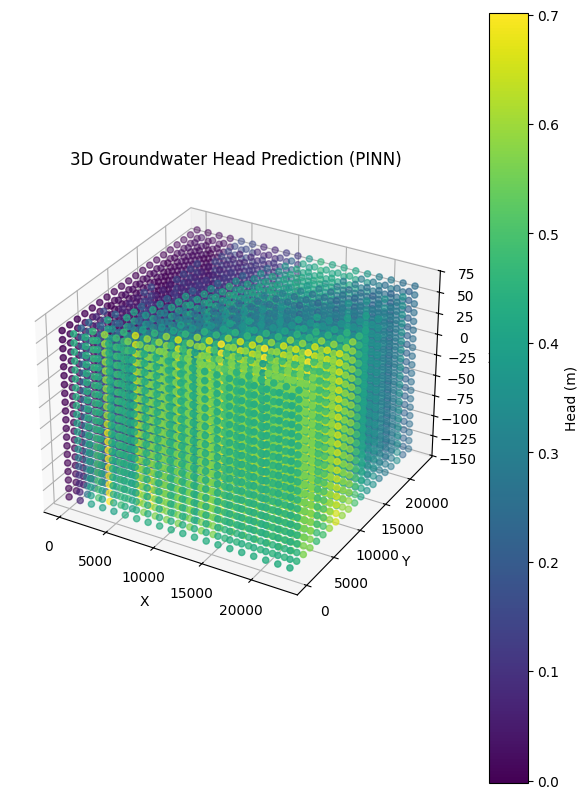

Epoch 9110: Loss = 1.5793e-05
Epoch 9120: Loss = 3.6254e-05
Epoch 9130: Loss = 1.6778e-05
Epoch 9140: Loss = 1.5828e-05
Epoch 9150: Loss = 1.7930e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9160: Loss = 1.6246e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9170: Loss = 1.5701e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9180: Loss = 1.5952e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9190: Loss = 1.5613e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

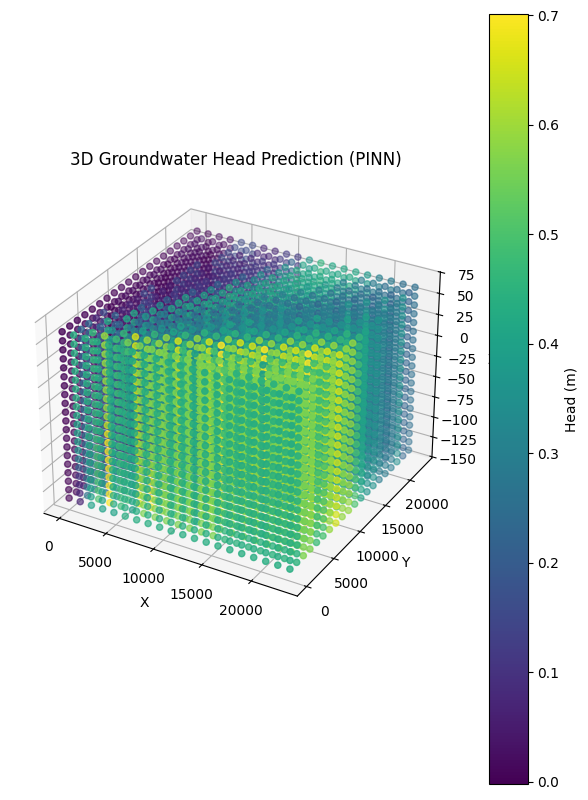

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9210: Loss = 1.5691e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9220: Loss = 1.5565e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9230: Loss = 1.5600e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9240: Loss = 1.5539e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9250: Loss = 1.5934e-05
✅ Parameters saved at /content

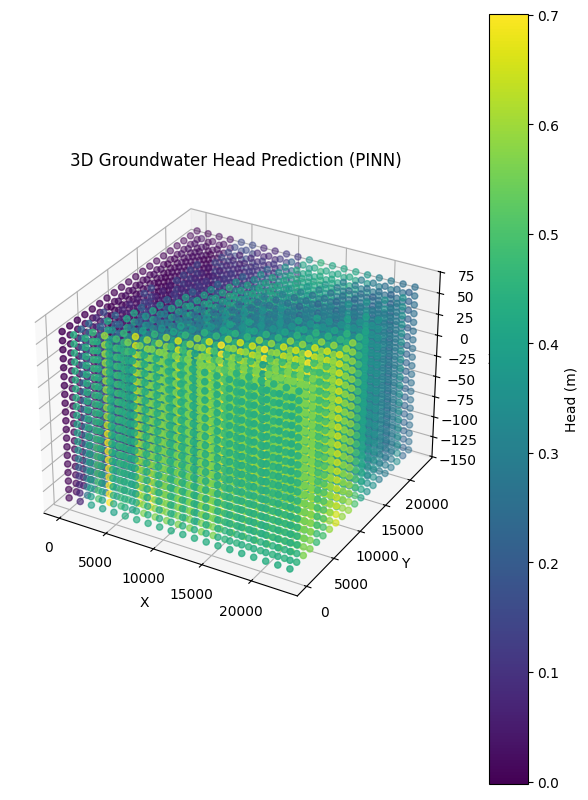

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9310: Loss = 1.5456e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9320: Loss = 1.5680e-05
Epoch 9330: Loss = 1.5999e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9340: Loss = 1.6349e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9350: Loss = 1.5389e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9360: Loss = 1.5367e-05


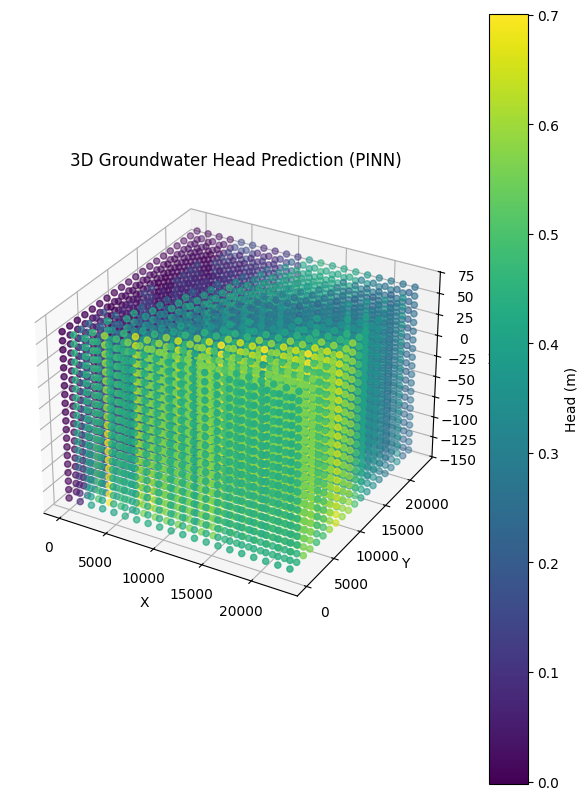

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9410: Loss = 1.5289e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9420: Loss = 1.5272e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9430: Loss = 1.5283e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9440: Loss = 1.5251e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9450: Loss = 1.5255e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9460: Loss = 1.5238e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl


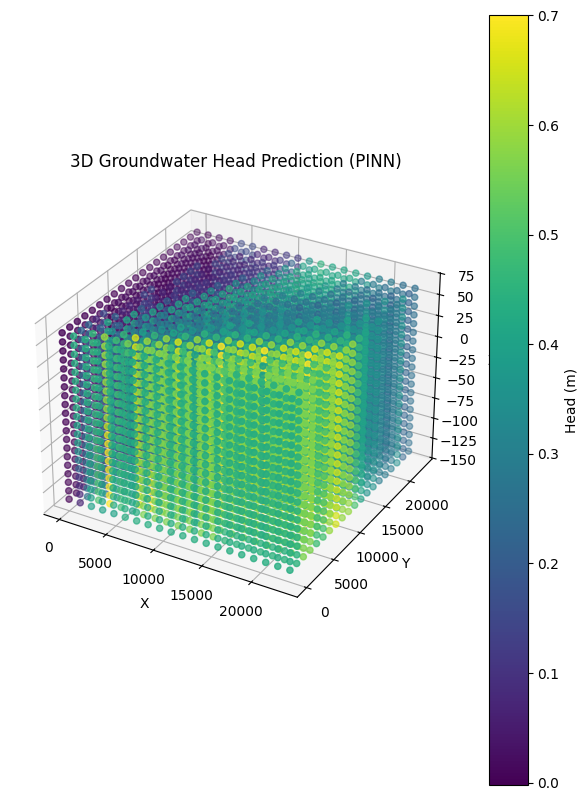

Epoch 9510: Loss = 1.6226e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9520: Loss = 1.5972e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9530: Loss = 1.5134e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9540: Loss = 1.5979e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9550: Loss = 1.5842e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9560: Loss = 1.5590e-05
Epoch 9570: Loss = 1.6647e-05
Epoch 9580: Loss = 1.6696e-05
Epoch 9590: Loss = 1.5270e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

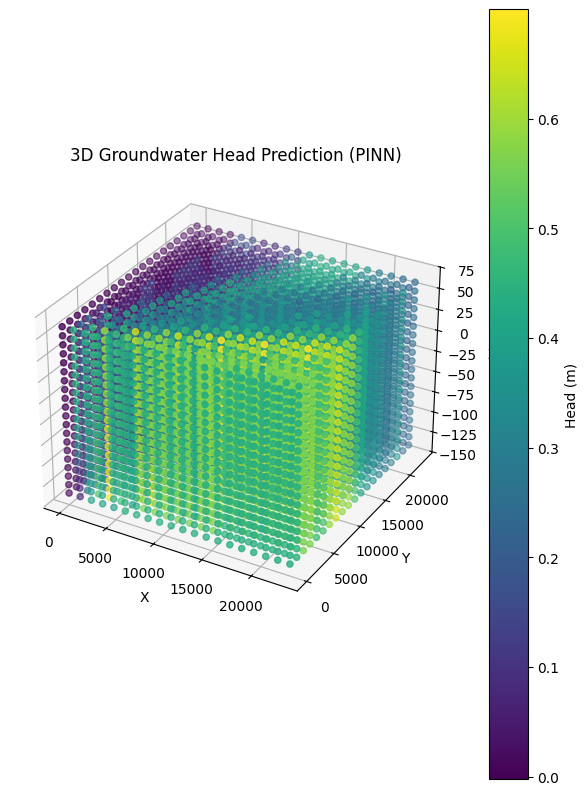

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9610: Loss = 1.4997e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9620: Loss = 1.4973e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9630: Loss = 1.5613e-05
Epoch 9640: Loss = 1.5004e-05
Epoch 9650: Loss = 1.4989e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9660: Loss = 1.5748e-05
Epoch 9670: Loss = 1.4957e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9680: Loss = 1.4926e-05
✅ Parameters saved at 

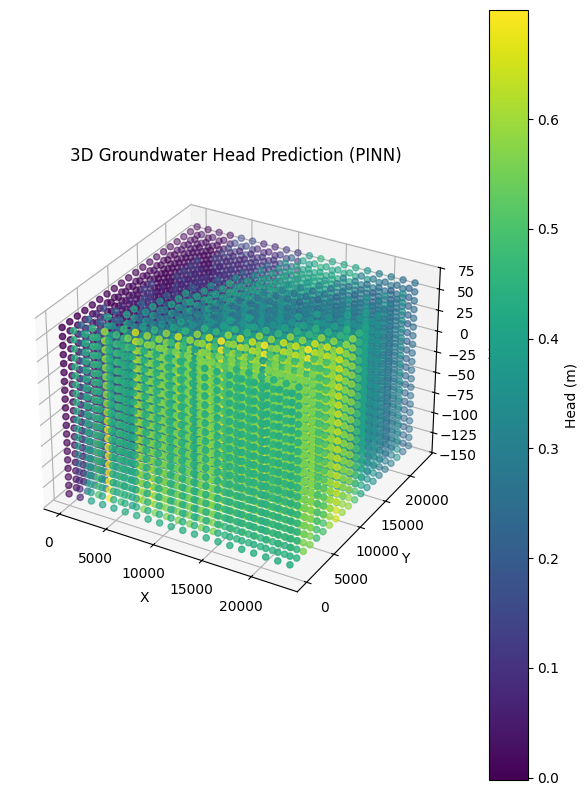

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9710: Loss = 1.4855e-05
Epoch 9720: Loss = 1.4864e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9730: Loss = 1.4817e-05
Epoch 9740: Loss = 1.4873e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9750: Loss = 1.5022e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content

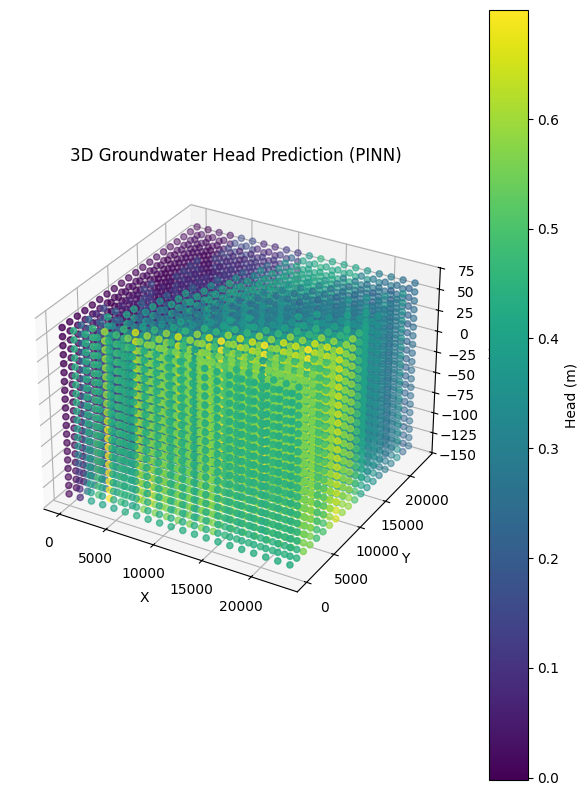

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9810: Loss = 1.4746e-05
Epoch 9820: Loss = 1.5652e-05
Epoch 9830: Loss = 1.5970e-05
Epoch 9840: Loss = 1.8457e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9850: Loss = 1.4695e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9860: Loss = 1.5233e-05
Epoch 9870: Loss = 1.5487e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9880: Loss = 1.5235e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9890: Loss = 1.4803e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrai

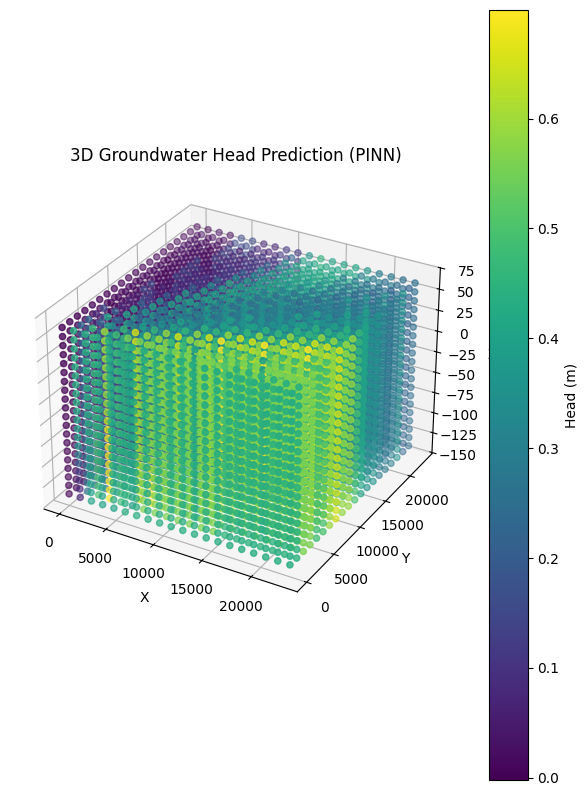

✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9910: Loss = 1.4601e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9920: Loss = 1.4595e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9930: Loss = 1.4525e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_0421_softconstrained.pkl
Epoch 9940: Loss = 1.4522e-05
✅ Parameters saved at /content/drive/MyDrive/best_params_042

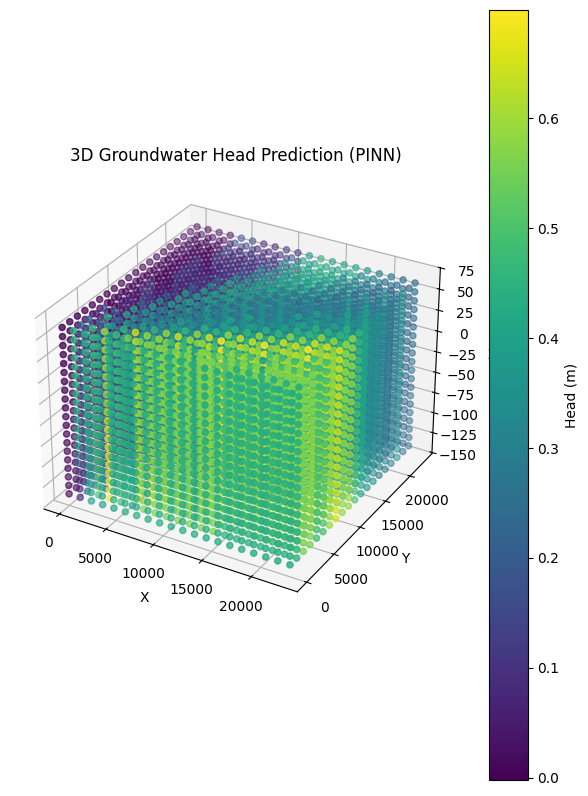


Best Model:
Best loss: 1.4432e-05 at iteration 9982



In [ ]:
# Training PINN
n_hl = 6  # Number of hidden layers
n_nodes = 50  # Number of nodes per layer
# lr = 5E-2  # Learning rate
epoch = 10000  # Number of epochs

layers = [3, 100, 200, 100, 1]  # Neural network architecture

(x_const, y_const, z_const, bc_const, BC_const,
    x_re, y_re, z_re,bc_re, BC_re,
    x_dr, y_dr, z_dr, q_dr, BC_dr,
    x_nf_xmin, y_nf_xmin, z_nf_xmin, bc_nf_xmin, BC_nf_xmin,
    x_nf_xmax, y_nf_xmax, z_nf_xmax, bc_nf_xmax, BC_nf_xmax,
    x_nf_ymin, y_nf_ymin, z_nf_ymin, bc_nf_ymin, BC_nf_ymin,
    x_nf_ymax, y_nf_ymax, z_nf_ymax, bc_nf_ymax, BC_nf_ymax,
    x_nf_zmin, y_nf_zmin, z_nf_zmin, bc_nf_zmin, BC_nf_zmin,
    x_c, y_c, z_c, colloc, conds) = generate_BCs_and_colloc(N_b, N_r, xmin, xmax, ymin, ymax, zmin, zmax)

# Initialize neural network
key = random.PRNGKey(1234)
params = init_mlp(layers, key)

# Initialize optimizer
# scheduler = optax.cosine_decay_schedule(init_value=1E-2, decay_steps=epoch, alpha=0.1)
scheduler = optax.cosine_decay_schedule(init_value=1E-3, decay_steps=epoch, alpha=0.05)
optimizer = optax.adam(scheduler)
opt_state = optimizer.init(params)
# colloc_h_init = jax.random.uniform(random.PRNGKey(0), shape=(colloc.shape[0], 1), minval=1, maxval=10)  # 초기 압력값을 랜덤하게 설정
colloc_h_init = jnp.zeros((colloc.shape[0],1))
def save_params(params, path):
    with open(path, 'wb') as f:
        pickle.dump(params, f)
    print(f"✅ Parameters saved at {path}")

def load_params(path):
    with open(path, 'rb') as f:
        params = pickle.load(f)
    print(f"✅ Parameters loaded from {path}")
    return params

save_path = '/content/drive/MyDrive/best_params_0421_softconstrained.pkl'

@jit
def update(params, opt_state, colloc, conds, colloc_h_init):
    """
    Perform one optimization step.
    """
    value, grads = jax.value_and_grad(loss_func)(params, colloc, conds, colloc_h_init)

    updates, opt_state = optimizer.update(grads, opt_state)
    params = optax.apply_updates(params, updates)
    return value, params, opt_state


# Training loop
all_losses = []
all_epochs = []
min_loss = jnp.inf
best_params = None

for i in range(epoch + 1):
    loss, params, opt_state = update(params, opt_state, colloc, conds, colloc_h_init)
    all_losses.append(loss)

    all_epochs.append(i)
    if loss < min_loss:
        min_loss = loss
        best_params = params
        best_iteration = i
        save_params(best_params, save_path)

      # 100 epoch마다 현재 params backup 저장
    if i % 100 == 0 and i != 0:
        save_params(params, f'/content/drive/MyDrive/backup_params_epoch_{i}.pkl')
        # 10 epoch마다 loss 출력
    if i % 10 == 0:
        print(f"Epoch {i}: Loss = {loss:.4e}")
    if i % 100 == 0:
        print(f"Epoch {i}: Loss = {loss:.4e}")
        # Predict head using the trained neural network
        h_pinn = neural_net(best_params, xyz_points )  # Output will be (nx*ny*nz, 1)
        h_pinn = h_pinn.reshape(nx, ny, nz)  # Reshape back to grid

        # 3D Visualization of PINN Solution
        fig = plt.figure(figsize=(16, 10))
        ax = fig.add_subplot(121, projection='3d')
        scat = ax.scatter(X, Y, Z, c=h_pinn.ravel(), cmap='viridis')
        plt.colorbar(scat, ax=ax, label='Head (m)')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_title('3D Groundwater Head Prediction (PINN)')

        plt.show()

print(f"\nBest Model:")
print(f"Best loss: {min_loss:.4e} at iteration {best_iteration}\n")

In [ ]:
load_params(content/drive/MyDrive/best_params.pkl)

NameError: name 'content' is not defined

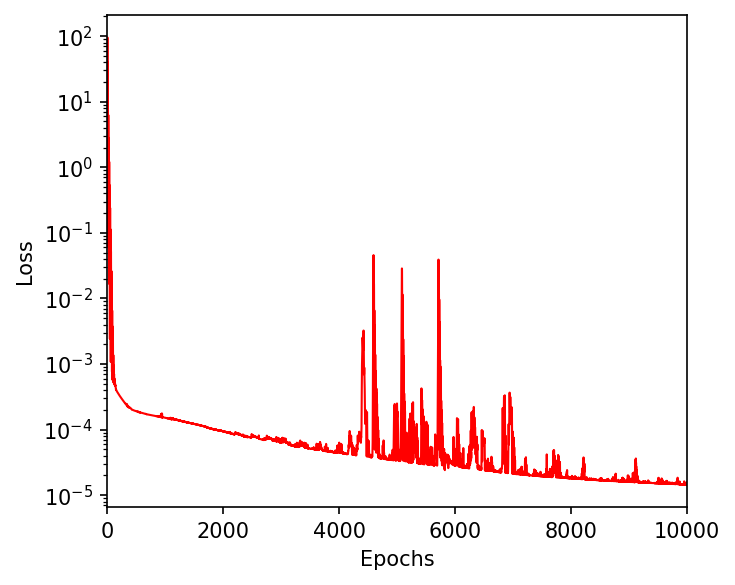

In [19]:
def plot_pinn_training(all_losses, all_epochs):
    plt.figure(figsize = (5, 4), dpi = 150)
    plt.semilogy(all_epochs, all_losses, '-r', markersize = 4, linewidth = 1.0)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    #plt.legend(prop={"size": fontsize_legend}, loc="best")
    plt.xlim(min(all_epochs), max(all_epochs))
    plt.tight_layout()

plot_pinn_training(all_losses, all_epochs)

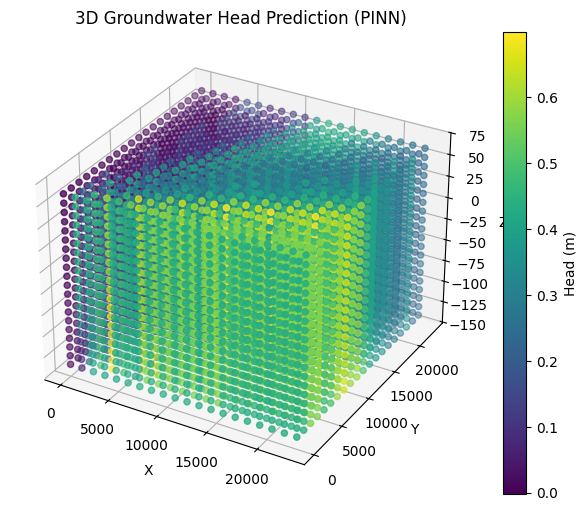

In [20]:
# 3D Visualization of PINN Solution
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
scat = ax.scatter(X, Y, Z, c=h_pinn.ravel(), cmap='viridis')
plt.colorbar(scat, ax=ax, label='Head (m)')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('3D Groundwater Head Prediction (PINN)')

plt.show()
